In [30]:
%load_ext autoreload
%autoreload 2


import scanpy as sc
import seaborn as sns
import pandas as pd
from scipy.stats import median_abs_deviation
from sklearn.mixture import GaussianMixture
import numpy as np
import matplotlib.pyplot as plt
import scrublet as scr
from tqdm.notebook import tqdm
from diptest import diptest
from scipy.sparse import csr_matrix
import anndata as ad
import math
import scvi
from dotenv import load_dotenv; load_dotenv()
import json
import os


from utils import preprocessing
from utils import DEG


# Hyperparamyters
BASE_PATH = os.getenv("BASE_PATH_FOR_SAVING")
DISEASE_TYPE = "diseased" # diseased / healthy
SAMPLE_ID = "sample_01" #"recon_241105"
ADATA_PATH = f'{BASE_PATH}/{DISEASE_TYPE}/{SAMPLE_ID}/adata/all_lib_adata_zoned.h5ad'

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Load

In [2]:
adata = sc.read_h5ad(ADATA_PATH)
adata

# ATTENTION: Only spatial cell in this notebook
adata = adata[adata.obs.has_spatial]
adata

View of AnnData object with n_obs × n_vars = 64705 × 32780
    obs: 'x', 'y', 'pct_intronic', 'is_cell', 'dbscan_clusters', 'dbscan_score', 'has_spatial', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Neighborhood_aggregate_probability', 'Class_name', 'Class_bootstrapping_probability', 'Class_aggregate_probability', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Subclass_aggregate_probability', 'Group_name', 'Group_bootstrapping_probability', 'Group_aggregate_probability', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'my_hierarchy_all', 'library', 'library_name', 'leiden_1', 'leiden_2', 'leiden_3', 'leiden_4', 'leiden_scANVI', 'mapping_MSN_for_zoning', 'zone', 'zone_probability', 'zone_cell_type'
    var: 'feature_types', 'genome', 'gene_symbol', 'highly_variable', 'highly_

<Axes: xlabel='x', ylabel='y'>

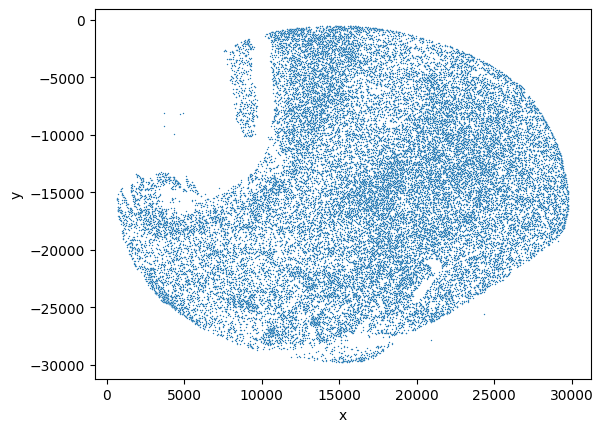

In [3]:
# Select single slice (not necesary for al dataset)

x_max = adata.obs.x.max()
x_mid = int(x_max/2)
x_1_4 = int(x_max/4)      # Center of left slice
x_3_4 = int(3*x_max/4)    # Center of right slice (fixed typo)

y_max = adata.obs.y.max()
y_mid = int(y_max/2)


adata = adata[adata.obs.x > x_mid].copy()

adata.obs.y -= y_max
adata.obs.x -= x_mid

sns.scatterplot(adata.obs, x="x", y="y", s=1)


# Show cell type annotations

{'Astrocyte': 'Astrocyte', 'ImAstro': 'ImAstro', 'Ependymal': 'Ependymal', 'B cells': 'B cells', 'T cells': 'T cells', 'BAM': 'BAM', 'Microglia': 'Microglia', 'Monocyte': 'Monocyte', 'COP': 'COP', 'OPC': 'OPC', 'ImOligo': 'ImOligo', 'Oligo OPALIN': 'Oligo OPALIN', 'Oligo PLEKHG1': 'Oligo PLEKHG1', 'Endo': 'Endo', 'Pericyte': 'Pericyte', 'SMC': 'SMC', 'VLMC': 'VLMC', 'BF SKOR1 Glut': 'BF SKOR1 Glut', 'STH PVALB-PITX2 Glut': 'STH PVALB-PITX2 Glut', 'VTR-HTH Glut': 'VTR-HTH Glut', 'SN SOX6 Dopa': 'SN SOX6 Dopa', 'SN-VTR CALB1 Dopa': 'SN-VTR CALB1 Dopa', 'SN-VTR GAD2 Dopa': 'SN-VTR GAD2 Dopa', 'LAMP5-CXCL14 GABA': 'LAMP5-CXCL14 GABA', 'VIP GABA': 'VIP GABA', 'LAMP5-LHX6 GABA': 'LAMP5-LHX6 GABA', 'STRd D1 Matrix MSN': 'STRd D1 Matrix MSN', 'STRd D1 Striosome MSN': 'STRd D1 Striosome MSN', 'STRv D1 MSN': 'STRv D1 MSN', 'STRd D2 Matrix MSN': 'STRd D2 Matrix MSN', 'STRd D2 StrioMat Hybrid MSN': 'STRd D2 StrioMat Hybrid MSN', 'STRd D2 Striosome MSN': 'STRd D2 Striosome MSN', 'STRv D2 MSN': 'STR

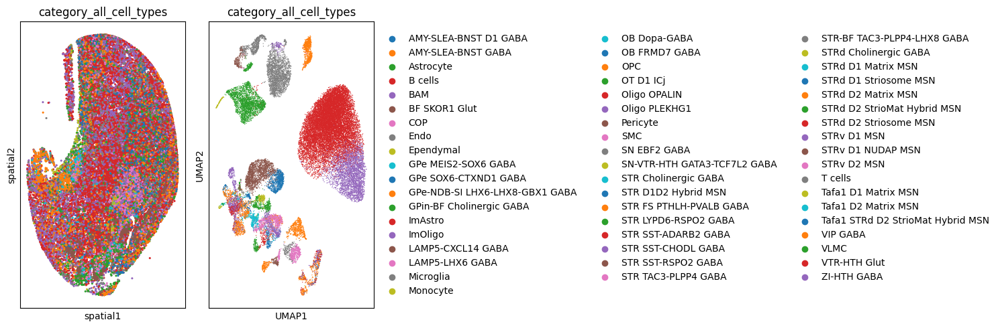

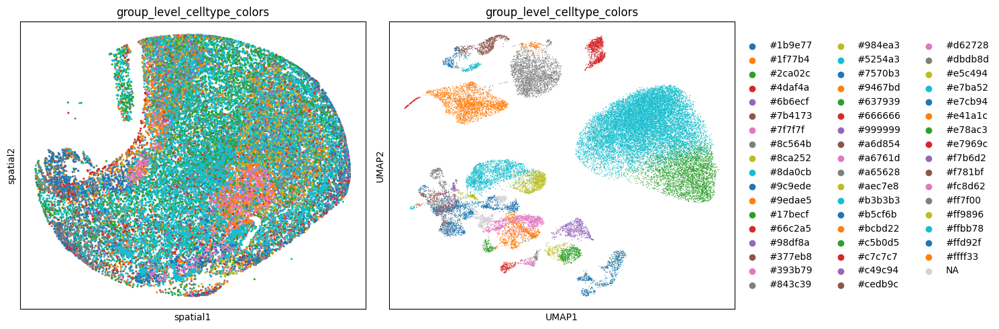

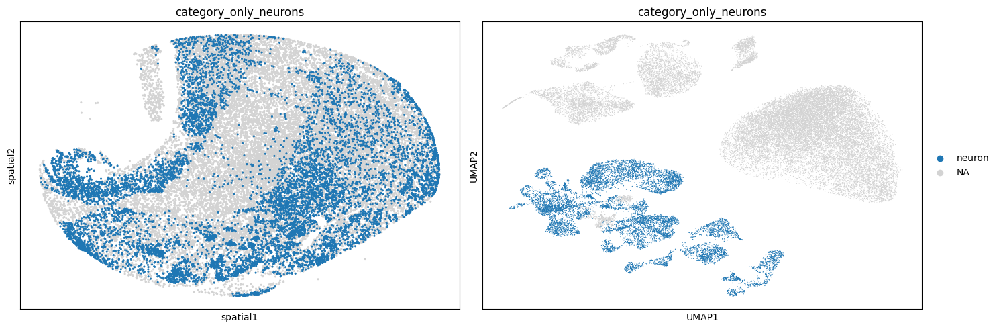

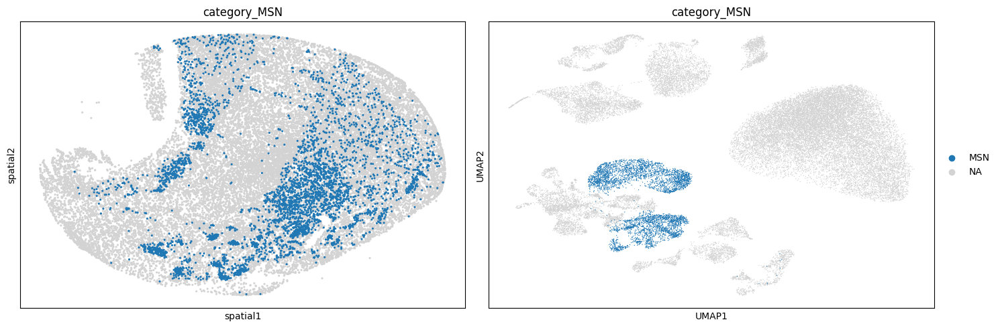

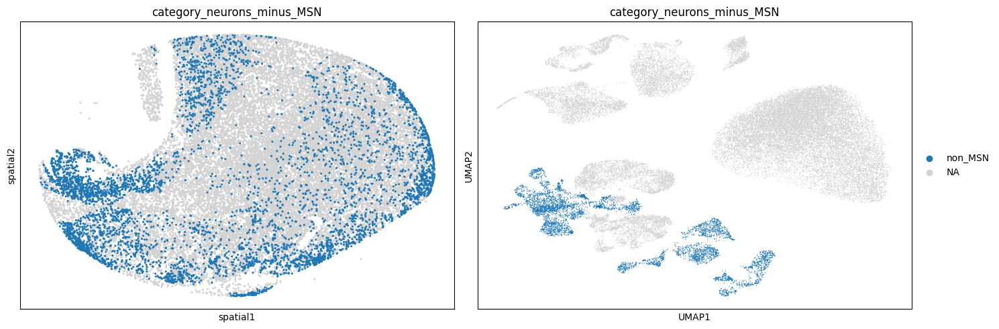

...

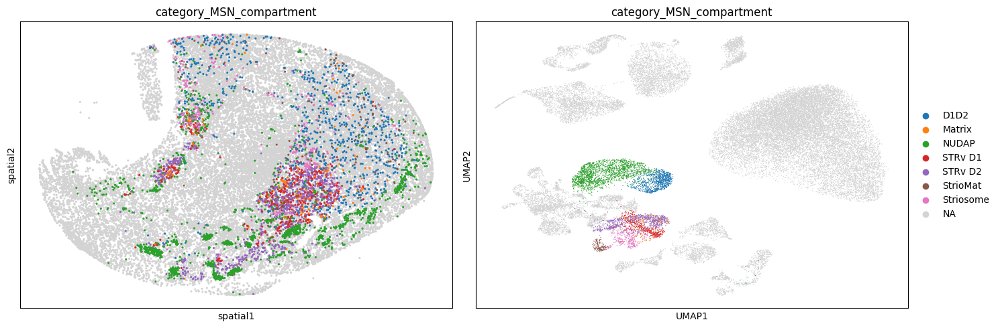

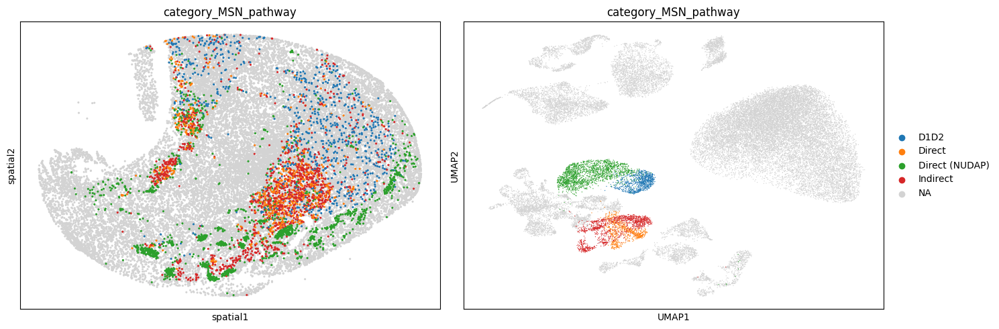

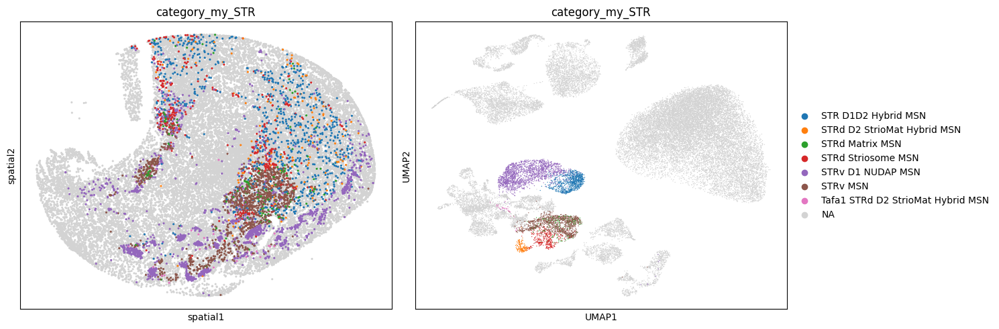

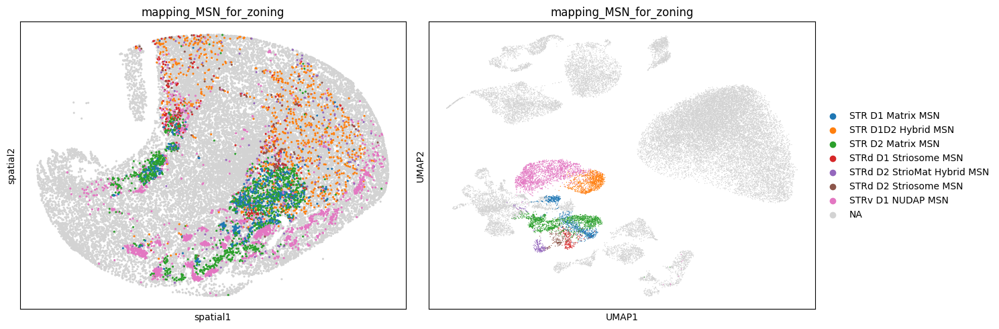

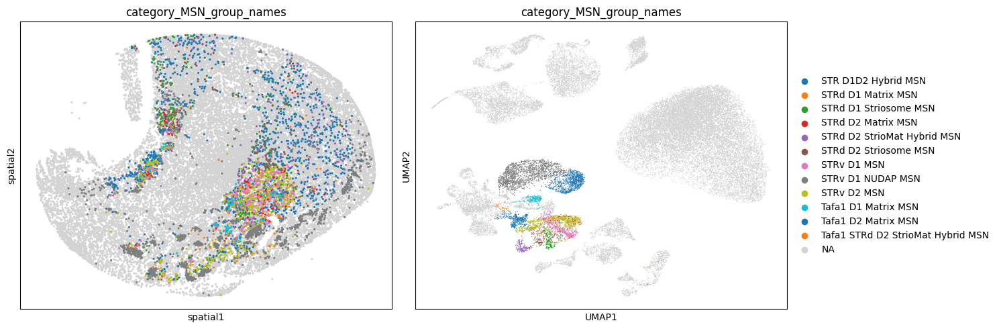

In [8]:
# Load the JSON file
with open(os.getenv("GROUP_LEVEL_MMC_MAPPING_PATH"), 'r') as f:
    classifications = json.load(f)

schemes = list(classifications.keys())

for classification in schemes:
    # Filter out annotation entries (those with keys starting with "_
    clean_mapping = {
        k: v for k, v in classifications[classification].items() 
        if not k.startswith("_")
    }
    print(clean_mapping)
    
    # Apply classification
    adata.obs[classification] = adata.obs['Group_name'].map(clean_mapping)

# Print summary statistics
for scheme in schemes:
    print(f"\n{scheme}:")
    print(f"  Unmapped (NaN): {adata.obs[scheme].isna().sum()}")


for i, res in enumerate(schemes):

    fig, axes = plt.subplots(1, 2, figsize=(15, 5))

    sc.pl.embedding(adata, basis="spatial", color=res, ax=axes[0], show=False, legend_loc=None, size=20, palette=sc.pl.palettes.vega_10  ) #     # First plot will generate colors and store them in adata.uns[f'{res}_colors']
    sc.pl.umap(adata, color=res, ax=axes[1], show=False)#, legend_loc="on data") #    # Second plot will automatically use the same colors from adata.uns


    plt.tight_layout()
    plt.show()

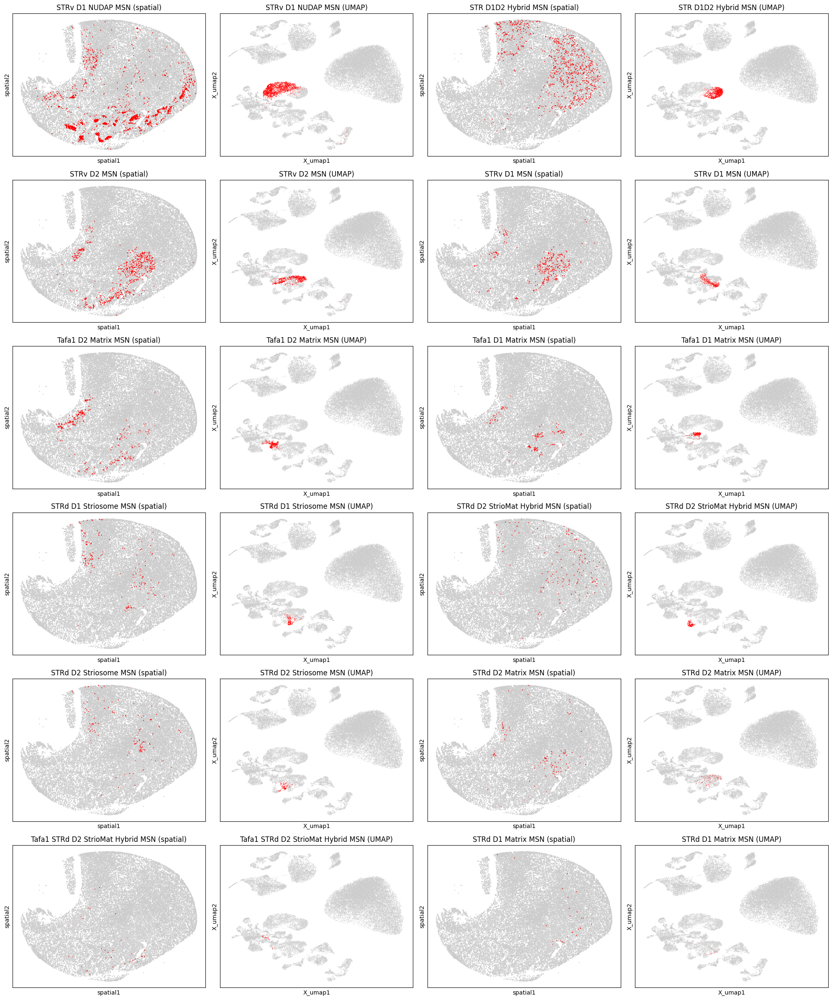

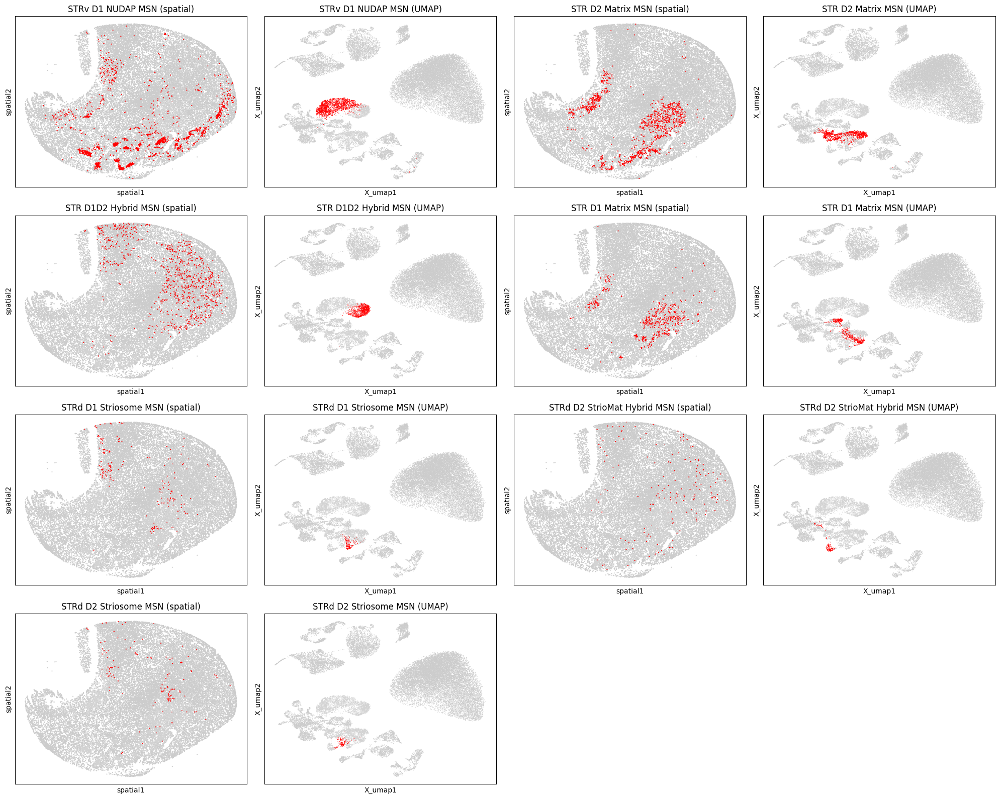

In [11]:
preprocessing.plot_spatial_umap_per_type(adata, ANNOTATION_LEVEL="category_MSN_group_names")
preprocessing.plot_spatial_umap_per_type(adata, ANNOTATION_LEVEL="mapping_MSN_for_zoning")


# Markers

In [ ]:
# adata_n = adata[adata.obs.Neighborhood_name != "Nonneuron"].copy()
# adata_n

In [ ]:
# QC_andrew = {

#     "D1": ['DRD1', 'PDYN', 'TAC1'],

#     "D2": ['DRD2', 'ADORA2A', 'GPR52'], 

#     "Striosome": ['OPRM1', 'FOXP2', 'UTS2B'],

#     "Matrix": ["CALB1", "PENK"],

#     "Claustrum": ["SLC17A6", "SLC17A7", "SLC17A8"],

#     "NUDAP": ["DRD1", "RXFP1"],

#     "eSTR": ["CASZ1", "LUZP2"]
# }

# adata_n.var.index = adata_n.var["gene_symbol"]
# adata_n.var.index = adata_n.var["gene_symbol"].astype(str)
# adata_n.var.index.name = '_index'
# adata_n.var_names_make_unique()

# preprocessing.calculate_and_plot_markers(adata_n, QC_andrew)

# OPC

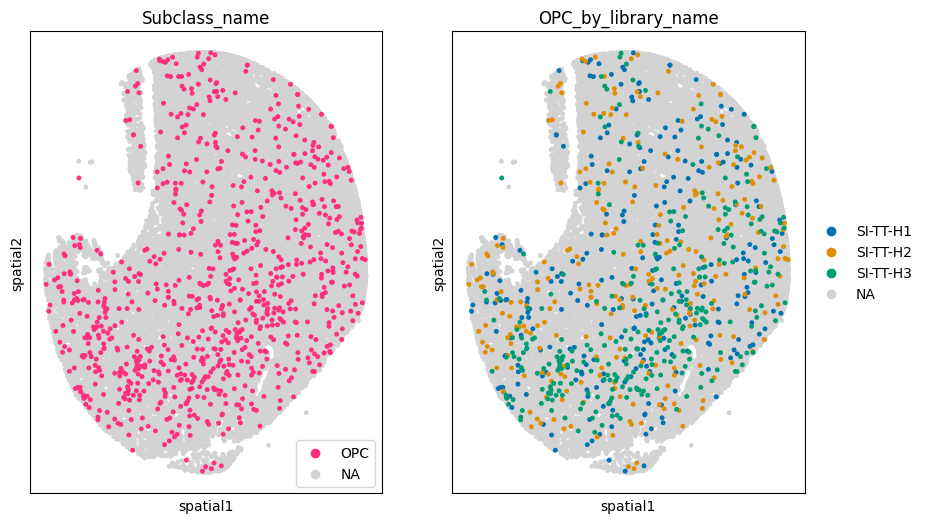

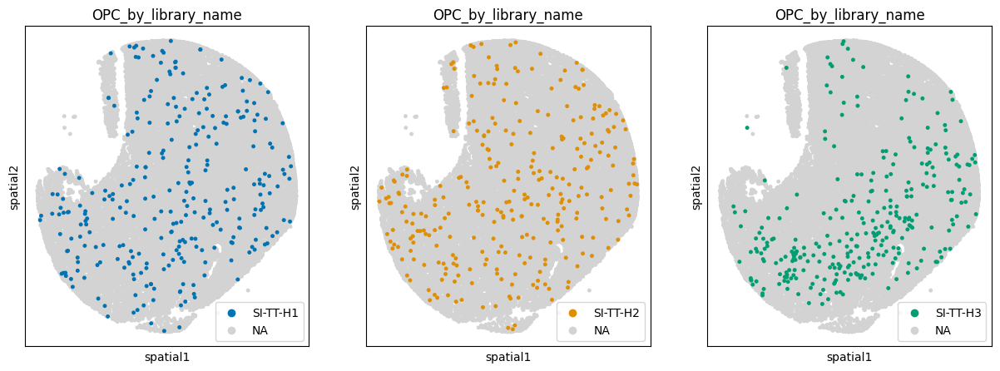

In [38]:
import numpy as np
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt

def plot_masked_embedding(adata, basis, select_obs, select_val, color_obs,
                          figsize=None, size=30, **kw):
    col = f"{select_val}_by_{color_obs}"

    # Create mask
    m = adata.obs[select_obs].isin(
        select_val if isinstance(select_val, (list, tuple, set)) else [select_val]
    )
    
    # Get categories from the color column
    cats = adata.obs[color_obs].astype("category").cat.categories
    
    # Create categorical column with proper categories
    adata.obs[col] = adata.obs[color_obs].astype("category")
    adata.obs.loc[~m, col] = np.nan
    
    # Set colors for all categories
    adata.uns[f"{col}_colors"] = sns.color_palette(
        "colorblind", len(cats)
    ).as_hex()

    # Create figure and axes
    if figsize is None:
        figsize = (8, 8)
    fig, ax = plt.subplots(1,2, figsize=figsize)

    sc.pl.embedding(
        adata,
        basis=basis,
        color=select_obs,
        groups=select_val,
        size=size,
        ax=ax[0],
        show=False,
        legend_loc="lower right",
        **kw
    )

    sc.pl.embedding(
        adata,
        basis=basis,
        color=col,
        size=size,
        ax=ax[1],
        show=False,
        **kw
    )
    
    plt.show()

    fig, ax = plt.subplots(1,len(cats), figsize=(5 * len(cats), 5))
    for i, cat in enumerate(cats):
        sc.pl.embedding(
            adata,
            basis=basis,
            color=col,
            groups=[cat],
            size=size,
            ax=ax[i],
            show=False,
            legend_loc="lower right",
            **kw
        )
    plt.show()


    adata.obs.drop(columns=col, inplace=True)
    adata.uns.pop(f"{col}_colors", None)


plot_masked_embedding(adata, "spatial", "Subclass_name", "OPC", "library_name", figsize=(10,6), size=50)

# Interferon

In [12]:
cts = ["Microglia", "T cells", "BAM", "ImAstro", "Astrocyte", "Endo", "Pericyte", "VLMC", "SMC"]
cts = adata.obs["Class_name"].unique().to_list()


/tmp/ipykernel_640709/3043948288.py:2: FutureWarning: Categorical.to_list is deprecated and will be removed in a future version. Use obj.tolist() instead
  cts = adata.obs["Class_name"].unique().to_list()


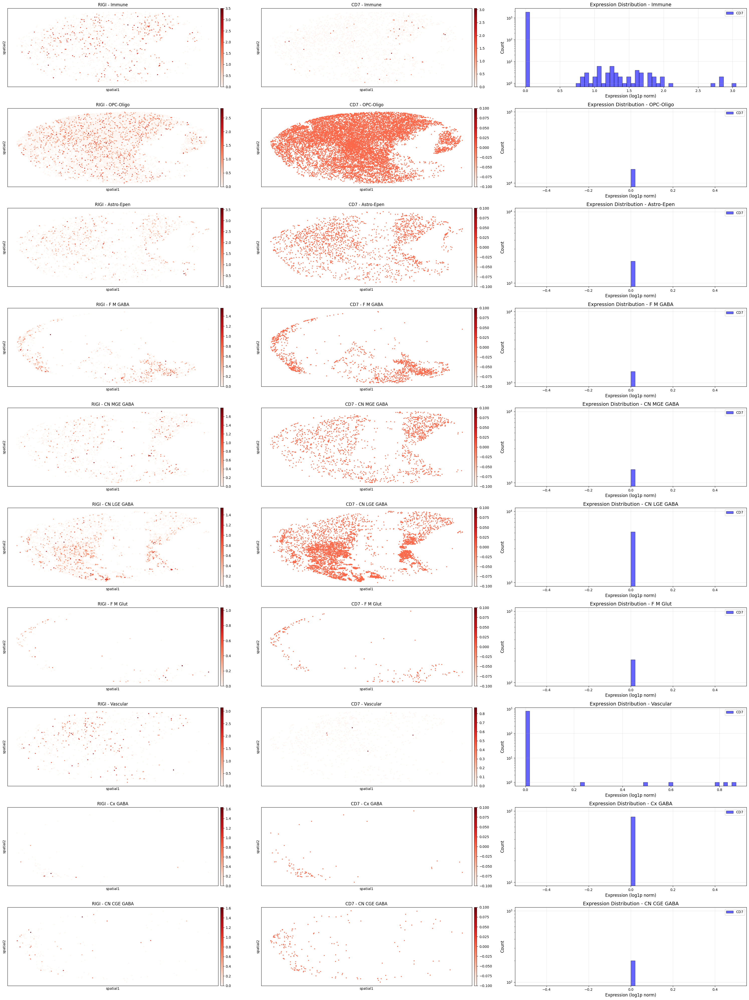

In [13]:
fig, axes = plt.subplots(len(cts), 3, figsize=(30, 40))

for i, ct in enumerate(cts):
    adata_spatial_ct = adata[adata.obs["Class_name"] == ct]
    
    # Plot spatial for each gene
    for j, gene in enumerate(["RIGI", "CD7"]):
        sc.pl.embedding(adata_spatial_ct, basis="spatial", color=gene, 
                        gene_symbols="gene_symbol", vmin=0,
                        layer="log1p_norm", show=False, size=30, cmap="Reds", 
                        ax=axes[i, j])
        axes[i, j].set_title(f"{gene} - {ct}")
    
    # Column 2: Histogram of gene expression for this cell type
    for gene, color in zip(["CD7"], ["blue"]):
        gene_idx = adata_spatial_ct.var[adata_spatial_ct.var.gene_symbol == gene].index[0]
        gene_expr = adata_spatial_ct[:, gene_idx].layers["log1p_norm"].toarray().flatten()
        
        axes[i, 2].hist(gene_expr, bins=50, alpha=0.6, label=gene, color=color, edgecolor='black')
    
    axes[i, 2].set_xlabel("Expression (log1p norm)", fontsize=12)
    axes[i, 2].set_ylabel("Count", fontsize=12)
    axes[i, 2].set_title(f"Expression Distribution - {ct}", fontsize=14)
    axes[i, 2].legend()
    axes[i, 2].grid(alpha=0.3)
    axes[i, 2].set_yscale("log")

plt.tight_layout()
plt.show()

# Find Line (LOD)

** Manually **

In [12]:
CELL_TYPE_FOR_LOD = "STRd D2 Matrix MSN" # DORSAL __< so we cna see how much the disease has gone down
CELL_TYPE_ANNOTATION_LOD = "category_MSN_group_names"

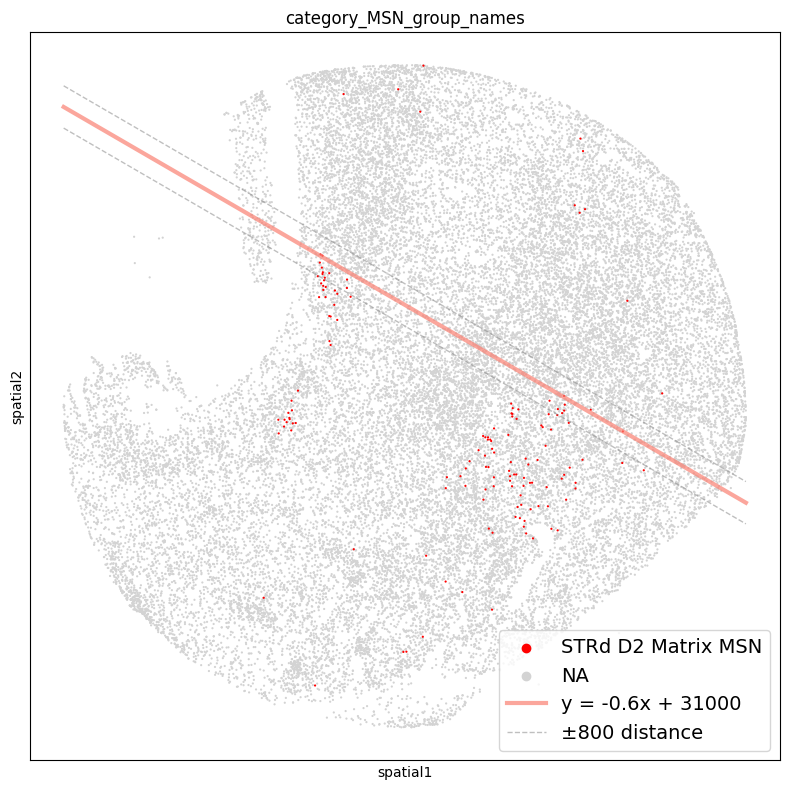

LOD_region
intact         18720
degenerated    14273
LOD             2500
Name: count, dtype: int64


In [21]:
# Set parameters
slope = -0.6
intercept = 31000
C = 800

# Save
adata.uns['boundary_line'] = {
    'slope': slope, 
    'intercept': intercept,
    'equation': f"y = {slope}x + {intercept}",
    'C': C,
}

# Distance each cell from the line
coords = adata.obsm['spatial']
x = coords[:, 0]
y = coords[:, 1]
adata.obs["distances_from_LOD"] = np.abs(slope * x - y + intercept) / np.sqrt(slope**2 + 1)

# Add col
adata.obs['LOD_region'] = [
    "LOD" if d < C
    else ("degenerated" if y_val > (slope * x_val + intercept) else "intact")
    for d, x_val, y_val in zip(
        adata.obs["distances_from_LOD"],
        x,
        y
    )
]

# Plot function
def plot_boundary(adata, color='my_hierarchy', groups=None):
    fig, ax = plt.subplots(figsize=(8, 8))

    colors = {c: "lightgray" for c in adata.obs[CELL_TYPE_ANNOTATION_LOD].cat.categories}
    colors[CELL_TYPE_FOR_LOD] = "red"
    sc.pl.embedding(adata, basis='spatial', color=color, groups=groups, 
                   size=10, ax=ax, show=False, palette=colors)
    
    b = adata.uns['boundary_line']
    coords = adata.obsm['spatial']
    x_line = np.linspace(coords[:, 0].min(), coords[:, 0].max(), 100)
    y_line = b['slope'] * x_line + b['intercept']

    # Main line
    ax.plot(x_line, y_line, 'salmon', linewidth=3, alpha=0.7, label=b['equation'])

    # Distance bands (±C)
    y_upper = y_line + b['C'] * np.sqrt(1 + b['slope']**2)
    y_lower = y_line - b['C'] * np.sqrt(1 + b['slope']**2)
    ax.plot(x_line, y_upper, 'grey', linewidth=1, linestyle='--', alpha=0.5, label=f'±{b["C"]} distance')
    ax.plot(x_line, y_lower, 'grey', linewidth=1, linestyle='--', alpha=0.5)

    ax.legend(fontsize=14)
    plt.tight_layout()
    plt.show()

# Use it - plot different colors
plot_boundary(adata, color=CELL_TYPE_ANNOTATION_LOD, groups=[CELL_TYPE_FOR_LOD])

# Check counts
print(adata.obs['LOD_region'].value_counts())

# Density

Density = Number of cells / Area

PROBLEM: Need a way to define the Area (spefici anatomical region)

## Define regions and calcualte area

here use convex hull --> in future need spcific anatomical regions

In [ ]:
# CELL_TYPE_ANNOTATION_FOR_DEG_DENSITY = "mapping_for_zoning" #"category_only_SPN"

In [22]:

# from scipy.spatial import ConvexHull
# import matplotlib.pyplot as plt

# fig, ax = plt.subplots(figsize=(12, 12))

# colors = {'LOD': 'blue', 'degenerated': 'orange', 'intact': 'green'}

# for region in ['LOD', 'degenerated', 'intact']:
#     # Get coordinates
#     mask = adata.obs['LOD_region'] == region
#     coords = adata.obsm['spatial'][mask]
    
#     # Plot all cells
#     ax.scatter(coords[:, 0], coords[:, 1], 
#               c=colors[region], alpha=0.3, s=1, label=f'{region} cells')
    
#     # Calculate and plot convex hull
#     hull = ConvexHull(coords)
    
#     # Get hull boundary points
#     for simplex in hull.simplices:
#         ax.plot(coords[simplex, 0], coords[simplex, 1], 
#                colors[region], linewidth=2)
    
#     # Calculate area
#     area = hull.volume
#     ax.text(coords[:, 0].mean(), coords[:, 1].mean(), 
#            f'{region}\nArea={area:.0f}', 
#            fontsize=12, fontweight='bold', ha='center',
#            bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))

# ax.set_xlabel('Spatial X')
# ax.set_ylabel('Spatial Y')
# ax.set_title('Convex Hull of Each Region', fontsize=14, fontweight='bold')
# ax.legend()
# ax.set_aspect('equal')
# plt.tight_layout()
# plt.show()

In [23]:
# # Quick density calculation
# from scipy.spatial import ConvexHull
# # ConvexHull calculates the smallest convex polygon that contains all points

# results = []
# for region in ['LOD', 'degenerated', 'intact']:

#     #Get all spatial coordinates for this region
#     coords = adata.obsm['spatial'][adata.obs['LOD_region'] == region]

#     # Calculate the AREA of this region
#     area = ConvexHull(coords).volume / 10000000 #.volume returns area (confusing name!)
#     #print(area)
    
#     for ct in adata.obs[CELL_TYPE_ANNOTATION_FOR_DEG_DENSITY].unique():
#         # Count how many cells of this type are in this region
#         n_cells = ((adata.obs['LOD_region'] == region) & 
#                    (adata.obs[CELL_TYPE_ANNOTATION_FOR_DEG_DENSITY] == ct)).sum()
#         results.append({'region': region, 'cell_type': ct, 
#                        'density': n_cells / area})

# density_df = pd.DataFrame(results)
# density_table = density_df.pivot(
#     index='cell_type', # Rows = cell types
#     columns='region', 
#     values='density')

# density_table = density_table[["intact", "LOD", "degenerated"]]

# # Heatmap
# sns.heatmap(density_table, annot=True, fmt='.5f', cmap='YlOrRd')
# plt.title('Cell Density by Region')
# plt.show()

In [24]:
# # Investigate regiosn where tehre is biggets chnage
# cts = adata.obs[CELL_TYPE_ANNOTATION_FOR_DEG_DENSITY].unique().tolist()[1:]#["STR D1D2 Hybrid MSN", "STRd Matrix MSN", "STRd Striosome MSN"]

# fig, axes = plt.subplots(len(cts), 2, figsize=(10, 5*len(cts)))

# for i, ct in enumerate(cts):
#     colors = {c: "lightgray" for c in adata.obs[CELL_TYPE_ANNOTATION_FOR_DEG_DENSITY].cat.categories}
#     colors[ct] = "red"
#     sc.pl.embedding(adata, basis="spatial", color=CELL_TYPE_ANNOTATION_FOR_DEG_DENSITY, ax=axes[i, 0], show=False, legend_loc=None, size=20, groups=ct, palette=colors)
#     sc.pl.umap(adata, color=CELL_TYPE_ANNOTATION_FOR_DEG_DENSITY, ax=axes[i, 1], show=False, legend_loc="on data", groups=ct, palette=colors)



#     b = adata.uns['boundary_line']
#     coords = adata.obsm['spatial']
#     x_line = np.linspace(coords[:, 0].min(), coords[:, 0].max(), 100)
#     y_line = b['slope'] * x_line + b['intercept']

#     ax.plot(x_line, y_line, 'salmon', linewidth=3, alpha=0.7, label=b['equation'])
#     y_upper = y_line + b['C'] * np.sqrt(1 + b['slope']**2)
#     y_lower = y_line - b['C'] * np.sqrt(1 + b['slope']**2)

#     # Main line
#     axes[i, 0].plot(x_line, y_line, 'salmon', linewidth=3, alpha=0.7, label=b['equation'])
#     axes[i, 0].plot(x_line, y_upper, 'grey', linewidth=1, linestyle='--', alpha=0.5, label=f'±{b["C"]} distance')
#     axes[i, 0].plot(x_line, y_lower, 'grey', linewidth=1, linestyle='--', alpha=0.5)


# plt.tight_layout()
# plt.show()

# DEGs in LOD: Wilcoxon (FindAllMarkers)

In [25]:
import numpy as np
import matplotlib.pyplot as plt
from adjustText import adjust_text

def add_spatial_with_boundary(ax, adata, cell_type, annotation_col):
    """
    Add spatial plot with boundary line to an existing axis.
    """
    # Set colors: highlight current cell type in red
    colors = {c: "lightgray" for c in adata.obs[annotation_col].cat.categories}
    colors[cell_type] = "red"
    
    # Spatial plot
    sc.pl.embedding(adata, basis="spatial", color=annotation_col, 
                   ax=ax, show=False, legend_loc="lower left", 
                   size=20, groups=[cell_type], palette=colors)
    
    # Get boundary line parameters
    b = adata.uns['boundary_line']
    coords = adata.obsm['spatial']
    x_line = np.linspace(coords[:, 0].min(), coords[:, 0].max(), 100)
    y_line = b['slope'] * x_line + b['intercept']
    y_upper = y_line + b['C'] * np.sqrt(1 + b['slope']**2)
    y_lower = y_line - b['C'] * np.sqrt(1 + b['slope']**2)
    
    # Add boundary lines
    ax.plot(x_line, y_line, 'salmon', linewidth=3, alpha=0.7, label=b['equation'])
    ax.plot(x_line, y_upper, 'grey', linewidth=1, linestyle='--', alpha=0.5, label=f'±{b["C"]} distance')
    ax.plot(x_line, y_lower, 'grey', linewidth=1, linestyle='--', alpha=0.5)

def plot_deg_simple(
    df_all, adata_plotting, CONTRAST, CELL_ANN,
    col_fc="logfoldchanges",
    col_p="pvals_adj",
    col_dir="direction",
    col_gene="gene_symbol",
    fc_thr=1, p_thr=0.05,
    top_bar=15, top_label=10
):

    if (df_all is None) or (df_all.empty):
        print("No df")
        return

    for ct in df_all.cell_type.unique():
        df = df_all[df_all.cell_type == ct].copy()
        
        # Convert to numeric at the start
        df[col_fc] = pd.to_numeric(df[col_fc], errors='coerce')
        df[col_p] = pd.to_numeric(df[col_p], errors='coerce').clip(lower=1e-300)
        df = df.dropna(subset=[col_fc, col_p])

        fig, ax = plt.subplots(1, 4, figsize=(24, 5))

        # ---------- Volcano ----------
        y = -np.log10(df[col_p])
        ax[0].scatter(df[col_fc], y, s=5, color="lightgrey")

        up = df[(df[col_fc] >= fc_thr) & (df[col_p] <= p_thr)]
        down = df[(df[col_fc] <= -fc_thr) & (df[col_p] <= p_thr)]

        if len(up) > 0:
            ax[0].scatter(up[col_fc], -np.log10(up[col_p]), s=10, c="red", label="UP")
        if len(down) > 0:
            ax[0].scatter(down[col_fc], -np.log10(down[col_p]), s=10, c="blue", label="DOWN")

        # Labels - only if we have significant genes
        texts = []
        to_label = []
        if len(up) > 0:
            to_label.append(up.nlargest(min(top_label, len(up)), col_fc))
        if len(down) > 0:
            to_label.append(down.nsmallest(min(top_label, len(down)), col_fc))
        
        if to_label:
            for _, r in pd.concat(to_label).iterrows():
                texts.append(ax[0].text(r[col_fc], -np.log10(r[col_p]), r[col_gene], fontsize=8))
            
            if texts:
                adjust_text(texts, ax=ax[0], arrowprops=dict(arrowstyle="-", lw=0.5))

        ax[0].axvline(fc_thr, ls="--", c="grey", alpha=0.5)
        ax[0].axvline(-fc_thr, ls="--", c="grey", alpha=0.5)
        ax[0].axhline(-np.log10(p_thr), ls="--", c="grey", alpha=0.5)
        ax[0].set(title=f"Volcano: {ct}", xlabel="log2FC", ylabel="-log10(FDR)")
        ax[0].legend()

        # ---------- UP bar ----------
        u = pd.DataFrame()  # Initialize
        if len(up) > 0:
            u = up.nlargest(min(top_bar, len(up)), col_fc)
            ax[1].barh(u[col_gene], u[col_fc], color="red")
            ax[1].invert_yaxis()
            ax[1].set_xlabel("log2FC")
        ax[1].set_title(f"UP in {CONTRAST[0]} (n={len(up)})")

        # ---------- DOWN bar ----------
        d = pd.DataFrame()  # Initialize
        if len(down) > 0:
            d = down.nsmallest(min(top_bar, len(down)), col_fc)
            ax[2].barh(d[col_gene], d[col_fc], color="blue")
            ax[2].invert_yaxis()
            ax[2].set_xlabel("log2FC")
        ax[2].set_title(f"DOWN in {CONTRAST[0]} (n={len(down)})")

        # ---------- Spatial ----------
        add_spatial_with_boundary(ax[3], adata_plotting, ct, CELL_ANN)
        ax[3].set_title("Cell localization")

        plt.suptitle(f"{ct}: {len(up)} UP, {len(down)} DOWN (total {len(df)} DEGs)", y=1.02, fontsize=14)
        plt.tight_layout()
        plt.show()

        # Print gene lists
        print(f"\n{ct}:")
        print(f"  UP genes ({len(up)}): {u[col_gene].tolist() if len(u) > 0 else []}")
        print(f"  DOWN genes ({len(down)}): {d[col_gene].tolist() if len(d) > 0 else []}")

In [26]:
CELL_TYPE_ANNOTATION_FOR_DEG_LOD = "category_MSN_group_names" #all_cell_types"
CONTRAST = ["degenerated", "intact"] #["LOD", "intact"]
MIN_CELLS_PER_GROUP = 5

adata.obs[CELL_TYPE_ANNOTATION_FOR_DEG_LOD].value_counts()

category_MSN_group_names
STRv D1 NUDAP MSN                    1784
STR D1D2 Hybrid MSN                   855
STRv D2 MSN                           821
STRv D1 MSN                           462
Tafa1 D2 Matrix MSN                   403
Tafa1 D1 Matrix MSN                   221
STRd D1 Striosome MSN                 201
STRd D2 StrioMat Hybrid MSN           154
STRd D2 Striosome MSN                 151
STRd D2 Matrix MSN                    148
Tafa1 STRd D2 StrioMat Hybrid MSN      34
STRd D1 Matrix MSN                     29
Name: count, dtype: int64

In [27]:
# Find marker genes for each cluster (equivalent to FindAllMarkers)
    # need log normlsied data --< NPY scaled
    # DEG: cluster Vs rest

deg_lod_lod_vs_intact = []

for ct in tqdm(adata.obs[CELL_TYPE_ANNOTATION_FOR_DEG_LOD].unique().tolist()):

    print(f"\n{ct}")
    # fig, axes = plt.subplots(figsize=(8, 5))
    # add_spatial_with_boundary(axes, adata, ct, CELL_TYPE_ANNOTATION_FOR_DEG_LOD)
    # plt.show()


    # filter cell type and location
    adata_ct = adata[
        (adata.obs[CELL_TYPE_ANNOTATION_FOR_DEG_LOD] == ct) &
        (adata.obs["LOD_region"].isin(CONTRAST))
        ].copy()
    
    # Remove unused categories after filtering
    adata_ct.obs["LOD_region"] = adata_ct.obs["LOD_region"].cat.remove_unused_categories()
    
    # CHECKS: if no cells in each region
    counts = adata_ct.obs["LOD_region"].value_counts()
    if not all(region in counts.index for region in CONTRAST):
        print(f"{ct}: missing regions. Found: {counts.index.tolist()}")
        continue
    # Check minimum cells per group
    if any(counts[region] < MIN_CELLS_PER_GROUP for region in CONTRAST):
        print(f"{ct}: too few cells. {CONTRAST[0]}={counts.get(CONTRAST[0], 0)}, {CONTRAST[1]}={counts.get(CONTRAST[1], 0)} (min={MIN_CELLS_PER_GROUP})")
        continue
    
    sc.tl.rank_genes_groups(
        adata_ct, 
        groupby="LOD_region",  # already filtering by cell type
        method='wilcoxon', 
        corr_method="benjamini-hochberg",

        groups=[CONTRAST[0]],
        reference=CONTRAST[1], 

        use_raw=False, 
        layer="log1p_norm", #ATTNETION: NOT scaled data in X

        pts = True, # ATTENTION; % cells expressing gene IN and OUT cluster 

        key_added="_".join(CONTRAST),

        rankby_abs=False
    )

    # Get top genes for this cluster
    deg_results_df = sc.get.rank_genes_groups_df(adata_ct, group=CONTRAST[0], key="_".join(CONTRAST))

    # Filer
    deg_results_df = deg_results_df[
        (deg_results_df.pvals_adj < 0.05) &
        (np.abs(deg_results_df.logfoldchanges) > 1) & # ATTENTION: both directions
        (deg_results_df['pct_nz_group'] > 0.1)   # only test genes that are detected in a minimum fraction  IN cluster

        # not apply here
        # (deg_results_df.scores > 0) &
        # (deg_results_df['pct_nz_reference'] < 0.50) & # only test genes NOT expressed outside
        # ((deg_results_df['pct_nz_group'] - deg_results_df['pct_nz_reference']) > 0.10) # Gene must be >10% more frequent in cluster than outside  
    ] 

    print(deg_results_df.shape)

    deg_results_df["cell_type"] = ct

    deg_lod_lod_vs_intact.append(deg_results_df)

# concat
deg_lod_lod_vs_intact = pd.concat(deg_lod_lod_vs_intact, ignore_index=True)

# mape gene naems
gene_symbol_map = adata.var["gene_symbol"].to_dict()
deg_lod_lod_vs_intact["gene_symbol"] = deg_lod_lod_vs_intact["names"].map(gene_symbol_map)

# Add regulation direction
deg_lod_lod_vs_intact["direction"] = deg_lod_lod_vs_intact["logfoldchanges"].apply(
    lambda x: f"UP in {CONTRAST[0]}" if x > 0 else f"DOWN in {CONTRAST[0]}"
)

# Add -log10p
deg_lod_lod_vs_intact["-log10p"] = -np.log10(deg_lod_lod_vs_intact["pvals_adj"])


deg_lod_lod_vs_intact

  0%|          | 0/13 [00:00<?, ?it/s]


nan
nan: missing regions. Found: []

STRv D1 MSN
(0, 6)

Tafa1 D2 Matrix MSN
Tafa1 D2 Matrix MSN: too few cells. degenerated=1, intact=400 (min=5)

STRv D2 MSN
STRv D2 MSN: too few cells. degenerated=2, intact=790 (min=5)

STRd D2 StrioMat Hybrid MSN
(168, 6)

STRv D1 NUDAP MSN
(233, 6)

STRd D2 Matrix MSN
(102, 6)

STRd D1 Striosome MSN
(194, 6)

Tafa1 STRd D2 StrioMat Hybrid MSN
Tafa1 STRd D2 StrioMat Hybrid MSN: too few cells. degenerated=1, intact=32 (min=5)

Tafa1 D1 Matrix MSN
Tafa1 D1 Matrix MSN: too few cells. degenerated=1, intact=219 (min=5)

STR D1D2 Hybrid MSN
(153, 6)

STRd D2 Striosome MSN
(126, 6)

STRd D1 Matrix MSN
(0, 6)


,names,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,cell_type,gene_symbol,direction,-log10p
0,ENSG00000198838,7.474536,1.779251,7.747643e-14,1.269839e-09,1.000000,STRd D2 StrioMat Hybrid MSN,RYR3,UP in degenerated,8.896251
1,ENSG00000105810,7.133199,1.837309,9.806237e-13,9.456416e-09,0.990291,STRd D2 StrioMat Hybrid MSN,CDK6,UP in degenerated,8.024273
2,ENSG00000144331,7.110776,3.456485,1.153925e-12,9.456416e-09,0.951456,STRd D2 StrioMat Hybrid MSN,ZNF385B,UP in degenerated,8.024273
3,ENSG00000122966,6.836709,1.658989,8.103288e-12,3.928859e-08,1.000000,STRd D2 StrioMat Hybrid MSN,CIT,UP in degenerated,7.405734
4,ENSG00000130226,6.801828,1.779617,1.032997e-11,4.173444e-08,1.000000,STRd D2 StrioMat Hybrid MSN,DPP6,UP in degenerated,7.379505
...,...,...,...,...,...,...,...,...,...,...
971,ENSG00000047648,-5.471121,-4.007057,4.471973e-08,6.663239e-05,0.101449,STRd D2 Striosome MSN,ARHGAP6,DOWN in degenerated,4.176315
972,ENSG00000241743,-5.572826,-2.585670,2.506398e-08,4.324196e-05,0.362319,STRd D2 Striosome MSN,XACT,DOWN in degenerated,4.364095
973,ENSG00000053438,-5.830080,-2.605387,5.540100e-09,1.297175e-05,0.550725,STRd D2 Striosome MSN,NNAT,DOWN in degenerated,4.887001
974,ENSG00000169855,-6.063402,-1.027578,1.332718e-09,3.971499e-06,1.000000,STRd D2 Striosome MSN,ROBO1,DOWN in degenerated,5.401046


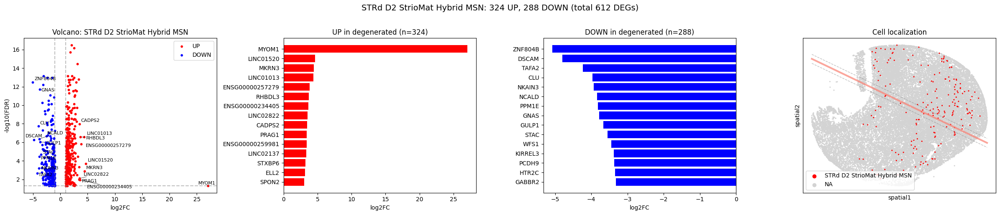


STRd D2 StrioMat Hybrid MSN:
  UP genes (324): ['MYOM1', 'LINC01520', 'MKRN3', 'LINC01013', 'ENSG00000257279', 'RHBDL3', 'ENSG00000234405', 'LINC02822', 'CADPS2', 'PRAG1', 'ENSG00000259981', 'LINC02137', 'STXBP6', 'ELL2', 'SPON2']
  DOWN genes (288): ['ZNF804B', 'DSCAM', 'TAFA2', 'CLU', 'NKAIN3', 'NCALD', 'PPM1E', 'GNAS', 'GULP1', 'STAC', 'WFS1', 'KIRREL3', 'PCDH9', 'HTR2C', 'GABBR2']


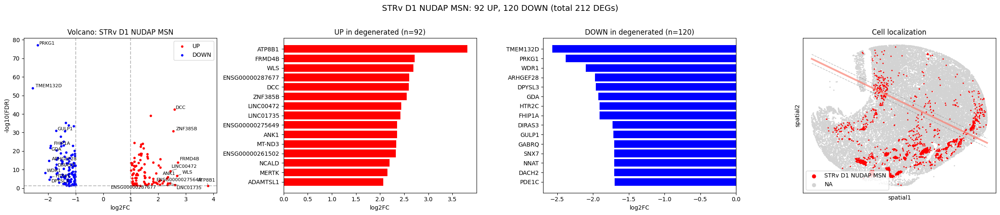


STRv D1 NUDAP MSN:
  UP genes (92): ['ATP8B1', 'FRMD4B', 'WLS', 'ENSG00000287677', 'DCC', 'ZNF385B', 'LINC00472', 'LINC01735', 'ENSG00000275649', 'ANK1', 'MT-ND3', 'ENSG00000261502', 'NCALD', 'MERTK', 'ADAMTSL1']
  DOWN genes (120): ['TMEM132D', 'PRKG1', 'WDR1', 'ARHGEF28', 'DPYSL3', 'GDA', 'HTR2C', 'FHIP1A', 'DIRAS3', 'GULP1', 'GABRQ', 'SNX7', 'NNAT', 'DACH2', 'PDE1C']


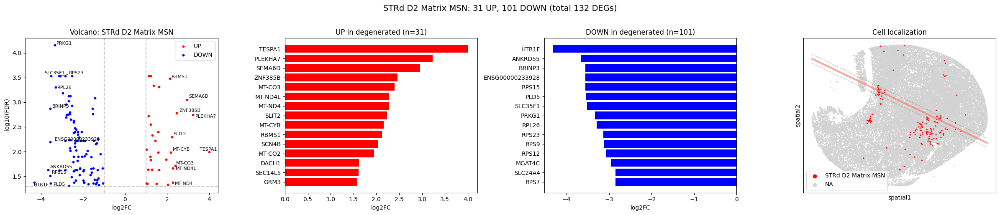


STRd D2 Matrix MSN:
  UP genes (31): ['TESPA1', 'PLEKHA7', 'SEMA6D', 'ZNF385B', 'MT-CO3', 'MT-ND4L', 'MT-ND4', 'SLIT2', 'MT-CYB', 'RBMS1', 'SCN4B', 'MT-CO2', 'DACH1', 'SEC14L5', 'GRM3']
  DOWN genes (101): ['HTR1F', 'ANKRD55', 'BRINP3', 'ENSG00000233928', 'RPS15', 'PLD5', 'SLC35F1', 'PRKG1', 'RPL26', 'RPS23', 'RPS9', 'RPS12', 'MGAT4C', 'SLC24A4', 'RPS7']


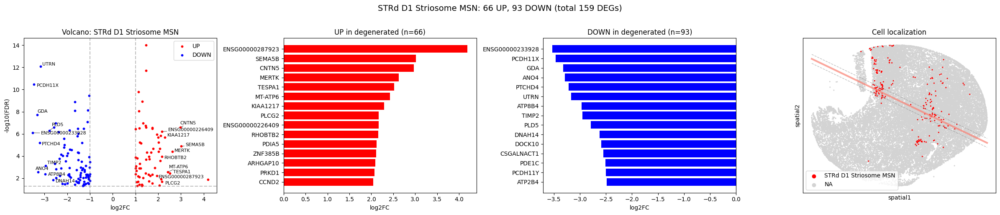


STRd D1 Striosome MSN:
  UP genes (66): ['ENSG00000287923', 'SEMA5B', 'CNTN5', 'MERTK', 'TESPA1', 'MT-ATP6', 'KIAA1217', 'PLCG2', 'ENSG00000226409', 'RHOBTB2', 'PDIA5', 'ZNF385B', 'ARHGAP10', 'PRKD1', 'CCND2']
  DOWN genes (93): ['ENSG00000233928', 'PCDH11X', 'GDA', 'ANO4', 'PTCHD4', 'UTRN', 'ATP8B4', 'TIMP2', 'PLD5', 'DNAH14', 'DOCK10', 'CSGALNACT1', 'PDE1C', 'PCDH11Y', 'ATP2B4']


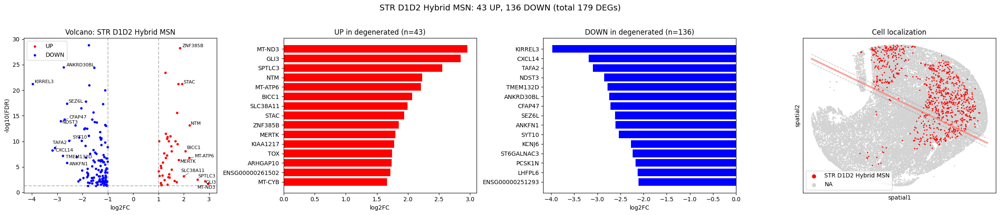


STR D1D2 Hybrid MSN:
  UP genes (43): ['MT-ND3', 'GLI3', 'SPTLC3', 'NTM', 'MT-ATP6', 'BICC1', 'SLC38A11', 'STAC', 'ZNF385B', 'MERTK', 'KIAA1217', 'TOX', 'ARHGAP10', 'ENSG00000261502', 'MT-CYB']
  DOWN genes (136): ['KIRREL3', 'CXCL14', 'TAFA2', 'NDST3', 'TMEM132D', 'ANKRD30BL', 'CFAP47', 'SEZ6L', 'ANKFN1', 'SYT10', 'KCNJ6', 'ST6GALNAC3', 'PCSK1N', 'LHFPL6', 'ENSG00000251293']


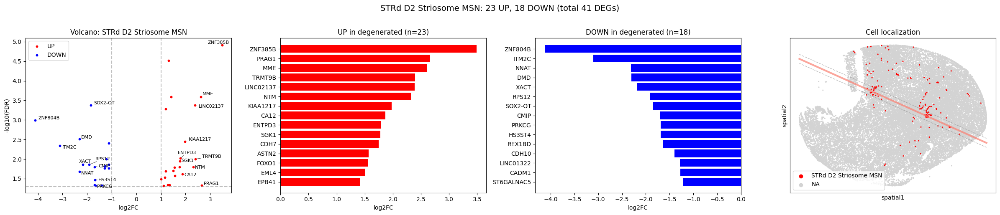


STRd D2 Striosome MSN:
  UP genes (23): ['ZNF385B', 'PRAG1', 'MME', 'TRMT9B', 'LINC02137', 'NTM', 'KIAA1217', 'CA12', 'ENTPD3', 'SGK1', 'CDH7', 'ASTN2', 'FOXO1', 'EML4', 'EPB41']
  DOWN genes (18): ['ZNF804B', 'ITM2C', 'NNAT', 'DMD', 'XACT', 'RPS12', 'SOX2-OT', 'CMIP', 'PRKCG', 'HS3ST4', 'REX1BD', 'CDH10', 'LINC01322', 'CADM1', 'ST6GALNAC5']


In [71]:
plot_deg_simple(
    deg_lod_lod_vs_intact,
    adata,
    CONTRAST,
    CELL_TYPE_ANNOTATION_FOR_DEG_LOD
)

# DEGs in LOD: MAST

## MAST Installation

### Base packages
```bash
sudo apt-get update
sudo apt-get install -y \
    build-essential \
    libcurl4-openssl-dev \
    libssl-dev \
    libxml2-dev \
    libfontconfig1-dev \
    libharfbuzz-dev \
    libfribidi-dev \
    libfreetype6-dev \
    libpng-dev \
    libtiff5-dev \
    libjpeg-dev \
    zlib1g-dev
```

### Install BiocManager and MAST
```bash
R -e "
# Install BiocManager
install.packages('BiocManager', repos='https://cloud.r-project.org/')

# Install MAST and dependencies
BiocManager::install(c('MAST', 'SingleCellExperiment', 'SummarizedExperiment'), 
                     update=TRUE, ask=FALSE)

install.packages('lme4', repos='https://cloud.r-project.org/')
"
```


### Verify
```bash
R -e "
library(MAST)
library(SingleCellExperiment)
cat('MAST installed successfully!\n')
cat('MAST version:', as.character(packageVersion('MAST')), '\n')
"
```

In [ ]:
# DEFINED BEFORE

# CELL_TYPE_ANNOTATION_FOR_DEG_LOD = "category_MSN_group_names" #all_cell_types"
# CONTRAST = ["degenerated", "intact"] #["LOD", "intact"]
# MIN_CELLS_PER_GROUP = 5

In [ ]:
# import rpy2.robjects as ro
# from rpy2.robjects import pandas2ri
# from rpy2.robjects.conversion import localconverter

In [28]:
adata.obs["sample"] = SAMPLE_ID
adata.obs.library.unique()

['240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1', '240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H2', '240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H3']
Categories (3, object): ['240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1', '240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H2', '240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H3']

  0%|          | 0/13 [00:00<?, ?it/s]


Running MAST for: nan
Contrast: degenerated vs intact (reference)

Cell counts: {}
ERROR: Insufficient cells
No df

Running MAST for: STRv D1 MSN
Contrast: degenerated vs intact (reference)

Cell counts: {'intact': 445, 'degenerated': 6}


,pct_counts_mt,log1p_n_genes_by_counts
pct_counts_mt,1.000000,0.045926
log1p_n_genes_by_counts,0.045926,1.000000


,LOD_region,sample,log1p_n_genes_by_counts,library,pct_counts_mt
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---AAACCAGCACTAGTCG-1-SI-TT-H1,intact,sample_01,1.871707,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,-0.933768
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---AATACCCCACGCAGTC-1-SI-TT-H1,intact,sample_01,-1.476796,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,-0.313498
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---AATATCCAGCATTACG-1-SI-TT-H1,intact,sample_01,0.778713,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,0.462692


Model Formula ~ label + library + log1p_n_genes_by_counts + pct_counts_mt


R callback write-console: Loading required package: SingleCellExperiment
  
R callback write-console: Loading required package: SummarizedExperiment
  
R callback write-console: Loading required package: MatrixGenerics
  
R callback write-console: Loading required package: matrixStats
  
R callback write-console: 
Attaching package: ‘MatrixGenerics’

  
R callback write-console: The following objects are masked from ‘package:matrixStats’:

    colAlls, colAnyNAs, colAnys, colAvgsPerRowSet, colCollapse,
    colCounts, colCummaxs, colCummins, colCumprods, colCumsums,
    colDiffs, colIQRDiffs, colIQRs, colLogSumExps, colMadDiffs,
    colMads, colMaxs, colMeans2, colMedians, colMins, colOrderStats,
    colProds, colQuantiles, colRanges, colRanks, colSdDiffs, colSds,
    colSums2, colTabulates, colVarDiffs, colVars, colWeightedMads,
    colWeightedMeans, colWeightedMedians, colWeightedSds,
    colWeightedVars, rowAlls, rowAnyNAs, rowAnys, rowAvgsPerColSet,
    rowCollapse, rowCounts, rowCu

class: SingleCellAssay 
dim: 12148 451 
metadata(0):
assays(1): X
rownames(12148): ENSG00000291215 ENSG00000237491 ... ENSG00000273748
  ENSG00000271254
rowData names(20): feature_types genome ... log1p_total_counts primerid
colnames(451):
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---AAACCAGCACTAGTCG-1-SI-TT-H1
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---AATACCCCACGCAGTC-1-SI-TT-H1
  ...
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H3---GTTGCTTTCCAACGTA-1-SI-TT-H3
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H3---GTTGTCTTCGCATACA-1-SI-TT-H3
colData names(6): LOD_region sample ... pct_counts_mt wellKey
reducedDimNames(0):
mainExpName: NULL
altExpNames(0):


R callback write-console: 
Done!
  
R callback write-console: Combining coefficients and standard errors
  
R callback write-console: Calculating log-fold changes
  


Processed 121480 groups out of 121480. 100% done. Time elapsed: 10s. ETA: 0s.


R callback write-console: Calculating likelihood ratio tests
  
R callback write-console: Refitting on reduced model...
  
R callback write-console: 
Done!
  
R callback write-console: In addition:   
R callback write-console: There were 50 or more warnings (use warnings() to see the first 50)  
R callback write-console: 
  
/tmp/ipykernel_289919/507824859.py:86: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax[0].legend()



RESULTS: 3 DEGs (FDR < 0.05)
↑ 2 UP / ↓ 1 DOWN


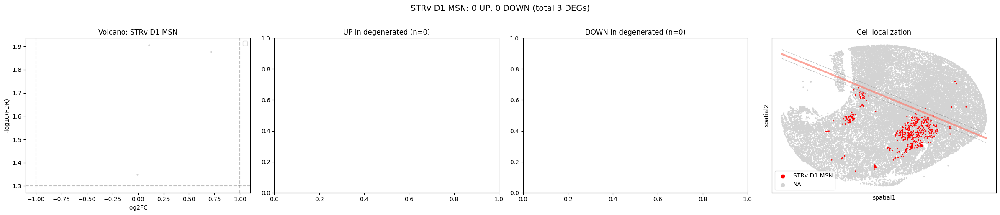


STRv D1 MSN:
  UP genes (0): []
  DOWN genes (0): []

Running MAST for: Tafa1 D2 Matrix MSN
Contrast: degenerated vs intact (reference)

Cell counts: {'intact': 400, 'degenerated': 1}
ERROR: Insufficient cells
No df

Running MAST for: STRv D2 MSN
Contrast: degenerated vs intact (reference)

Cell counts: {'intact': 790, 'degenerated': 2}
ERROR: Insufficient cells
No df

Running MAST for: STRd D2 StrioMat Hybrid MSN
Contrast: degenerated vs intact (reference)

Cell counts: {'degenerated': 103, 'intact': 34}


,pct_counts_mt,log1p_n_genes_by_counts
pct_counts_mt,1.000000,-0.454547
log1p_n_genes_by_counts,-0.454547,1.000000


,LOD_region,sample,log1p_n_genes_by_counts,library,pct_counts_mt
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---AAACTTATCCATCATC-1-SI-TT-H1,degenerated,sample_01,2.079833,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,0.337428
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---AAGCCATGTGCATGGC-1-SI-TT-H1,intact,sample_01,-0.575396,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,0.261601
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---ACCAATGTCGCTTAAG-1-SI-TT-H1,degenerated,sample_01,2.211529,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,-0.512448


Model Formula ~ label + library + log1p_n_genes_by_counts + pct_counts_mt


R callback write-console: `fData` has no primerid.  I'll make something up.
  
R callback write-console: `cData` has no wellKey.  I'll make something up.
  
R callback write-console: Assuming data assay in position 1, with name X is log-transformed.
  


class: SingleCellAssay 
dim: 12083 137 
metadata(0):
assays(1): X
rownames(12083): ENSG00000291215 ENSG00000237491 ... ENSG00000278384
  ENSG00000273748
rowData names(20): feature_types genome ... log1p_total_counts primerid
colnames(137):
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---AAACTTATCCATCATC-1-SI-TT-H1
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---AAGCCATGTGCATGGC-1-SI-TT-H1
  ...
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H3---GTTGCAGGTATGTTAG-1-SI-TT-H3
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H3---GTTGTCCGTCCTATGC-1-SI-TT-H3
colData names(6): LOD_region sample ... pct_counts_mt wellKey
reducedDimNames(0):
mainExpName: NULL
altExpNames(0):


R callback write-console: 
Done!
  
R callback write-console: Combining coefficients and standard errors
  
R callback write-console: Calculating log-fold changes
  


Processed 120830 groups out of 120830. 100% done. Time elapsed: 11s. ETA: 0s.


R callback write-console: Calculating likelihood ratio tests
  
R callback write-console: Refitting on reduced model...
  
R callback write-console: 
Done!
  
R callback write-console: In addition:   
R callback write-console: There were 50 or more warnings (use warnings() to see the first 50)  
R callback write-console: 
  



RESULTS: 339 DEGs (FDR < 0.05)
↑ 199 UP / ↓ 140 DOWN


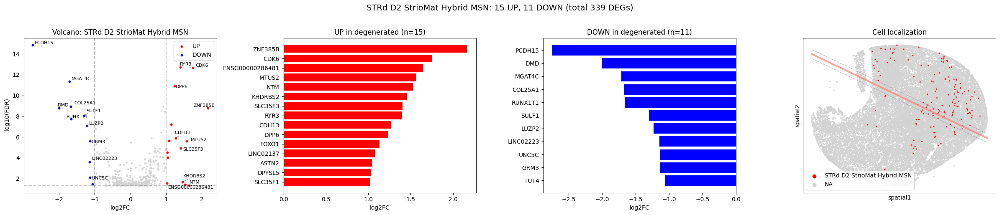


STRd D2 StrioMat Hybrid MSN:
  UP genes (15): ['ZNF385B', 'CDK6', 'ENSG00000286481', 'MTUS2', 'NTM', 'KHDRBS2', 'SLC35F3', 'RYR3', 'CDH13', 'DPP6', 'FOXO1', 'LINC02137', 'ASTN2', 'DPYSL5', 'SLC35F1']
  DOWN genes (11): ['PCDH15', 'DMD', 'MGAT4C', 'COL25A1', 'RUNX1T1', 'SULF1', 'LUZP2', 'LINC02223', 'UNC5C', 'GRM3', 'TUT4']

Running MAST for: STRv D1 NUDAP MSN
Contrast: degenerated vs intact (reference)

Cell counts: {'intact': 1446, 'degenerated': 231}


,pct_counts_mt,log1p_n_genes_by_counts
pct_counts_mt,1.000000,-0.028625
log1p_n_genes_by_counts,-0.028625,1.000000


,LOD_region,sample,log1p_n_genes_by_counts,library,pct_counts_mt
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---AAAGCGTAGGGAATTA-1-SI-TT-H1,intact,sample_01,1.001764,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,1.322133
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---AACAGCCTCGTATTCC-1-SI-TT-H1,intact,sample_01,1.696271,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,-0.482027
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---AACCCCTGTATCGCTC-1-SI-TT-H1,intact,sample_01,2.634540,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,0.669933


Model Formula ~ label + library + log1p_n_genes_by_counts + pct_counts_mt


R callback write-console: `fData` has no primerid.  I'll make something up.
  
R callback write-console: `cData` has no wellKey.  I'll make something up.
  
R callback write-console: Assuming data assay in position 1, with name X is log-transformed.
  


class: SingleCellAssay 
dim: 10887 1677 
metadata(0):
assays(1): X
rownames(10887): ENSG00000291215 ENSG00000237491 ... ENSG00000278384
  ENSG00000273748
rowData names(20): feature_types genome ... log1p_total_counts primerid
colnames(1677):
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---AAAGCGTAGGGAATTA-1-SI-TT-H1
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---AACAGCCTCGTATTCC-1-SI-TT-H1
  ...
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H3---GTTGTCTTCCCAGAAC-1-SI-TT-H3
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H3---GTTGTGCAGAAACGGT-1-SI-TT-H3
colData names(6): LOD_region sample ... pct_counts_mt wellKey
reducedDimNames(0):
mainExpName: NULL
altExpNames(0):


R callback write-console: 
Done!
  
R callback write-console: Combining coefficients and standard errors
  
R callback write-console: Calculating log-fold changes
  


Processed 108870 groups out of 108870. 100% done. Time elapsed: 8s. ETA: 0s.


R callback write-console: Calculating likelihood ratio tests
  
R callback write-console: Refitting on reduced model...
  
R callback write-console: 
Done!
  
R callback write-console: In addition:   
R callback write-console: There were 50 or more warnings (use warnings() to see the first 50)  
R callback write-console: 
  



RESULTS: 3743 DEGs (FDR < 0.05)
↑ 1364 UP / ↓ 2379 DOWN


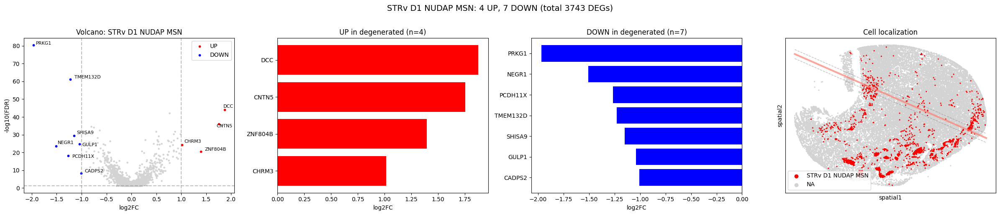


STRv D1 NUDAP MSN:
  UP genes (4): ['DCC', 'CNTN5', 'ZNF804B', 'CHRM3']
  DOWN genes (7): ['PRKG1', 'NEGR1', 'PCDH11X', 'TMEM132D', 'SHISA9', 'GULP1', 'CADPS2']

Running MAST for: STRd D2 Matrix MSN
Contrast: degenerated vs intact (reference)

Cell counts: {'intact': 119, 'degenerated': 11}


,pct_counts_mt,log1p_n_genes_by_counts
pct_counts_mt,1.000000,-0.200244
log1p_n_genes_by_counts,-0.200244,1.000000


,LOD_region,sample,log1p_n_genes_by_counts,library,pct_counts_mt
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---AAATTGCTCACATGTG-1-SI-TT-H1,intact,sample_01,2.187441,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,0.039676
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---ACTGTTGAGCCGATTA-1-SI-TT-H1,intact,sample_01,-0.147920,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,0.027222
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---AGACGCAAGGCGCATT-1-SI-TT-H1,intact,sample_01,-3.059709,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,-0.569193


Model Formula ~ label + library + log1p_n_genes_by_counts + pct_counts_mt


R callback write-console: `fData` has no primerid.  I'll make something up.
  
R callback write-console: `cData` has no wellKey.  I'll make something up.
  
R callback write-console: Assuming data assay in position 1, with name X is log-transformed.
  


class: SingleCellAssay 
dim: 11678 130 
metadata(0):
assays(1): X
rownames(11678): ENSG00000291215 ENSG00000237491 ... ENSG00000278384
  ENSG00000273748
rowData names(20): feature_types genome ... log1p_total_counts primerid
colnames(130):
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---AAATTGCTCACATGTG-1-SI-TT-H1
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---ACTGTTGAGCCGATTA-1-SI-TT-H1
  ...
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H3---GTGAGTTGTACGTCTC-1-SI-TT-H3
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H3---GTGTCCTGTACAGGTT-1-SI-TT-H3
colData names(6): LOD_region sample ... pct_counts_mt wellKey
reducedDimNames(0):
mainExpName: NULL
altExpNames(0):


R callback write-console: 
Done!
  
R callback write-console: Combining coefficients and standard errors
  
R callback write-console: Calculating log-fold changes
  


Processed 116780 groups out of 116780. 100% done. Time elapsed: 10s. ETA: 0s.


R callback write-console: Calculating likelihood ratio tests
  
R callback write-console: Refitting on reduced model...
  
R callback write-console: 
Done!
  
R callback write-console: In addition:   
R callback write-console: There were 50 or more warnings (use warnings() to see the first 50)  
R callback write-console: 
  



RESULTS: 201 DEGs (FDR < 0.05)
↑ 127 UP / ↓ 74 DOWN


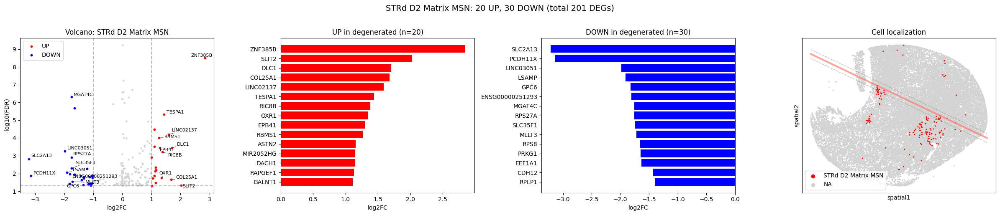


STRd D2 Matrix MSN:
  UP genes (20): ['ZNF385B', 'SLIT2', 'DLC1', 'COL25A1', 'LINC02137', 'TESPA1', 'RIC8B', 'OXR1', 'EPB41', 'RBMS1', 'ASTN2', 'MIR2052HG', 'DACH1', 'RAPGEF1', 'GALNT1']
  DOWN genes (30): ['SLC2A13', 'PCDH11X', 'LINC03051', 'LSAMP', 'GPC6', 'ENSG00000251293', 'MGAT4C', 'RPS27A', 'SLC35F1', 'MLLT3', 'RPS8', 'PRKG1', 'EEF1A1', 'CDH12', 'RPLP1']

Running MAST for: STRd D1 Striosome MSN
Contrast: degenerated vs intact (reference)

Cell counts: {'degenerated': 84, 'intact': 67}


,pct_counts_mt,log1p_n_genes_by_counts
pct_counts_mt,1.000000,-0.077664
log1p_n_genes_by_counts,-0.077664,1.000000


,LOD_region,sample,log1p_n_genes_by_counts,library,pct_counts_mt
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---AACTCCCGTCCAGAAT-1-SI-TT-H1,intact,sample_01,1.900901,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,1.055721
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---ACACCCGAGCTTAGTG-1-SI-TT-H1,intact,sample_01,1.728421,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,0.957445
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---AGCAGGGGTGGCAAGG-1-SI-TT-H1,degenerated,sample_01,2.157797,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,0.130383


Model Formula ~ label + library + log1p_n_genes_by_counts + pct_counts_mt


R callback write-console: `fData` has no primerid.  I'll make something up.
  
R callback write-console: `cData` has no wellKey.  I'll make something up.
  
R callback write-console: Assuming data assay in position 1, with name X is log-transformed.
  


class: SingleCellAssay 
dim: 12661 151 
metadata(0):
assays(1): X
rownames(12661): ENSG00000291215 ENSG00000237491 ... ENSG00000273748
  ENSG00000271254
rowData names(20): feature_types genome ... log1p_total_counts primerid
colnames(151):
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---AACTCCCGTCCAGAAT-1-SI-TT-H1
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---ACACCCGAGCTTAGTG-1-SI-TT-H1
  ...
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H3---GTTCATTGTAAGCGTT-1-SI-TT-H3
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H3---GTTGTCTTCCGACTAA-1-SI-TT-H3
colData names(6): LOD_region sample ... pct_counts_mt wellKey
reducedDimNames(0):
mainExpName: NULL
altExpNames(0):


R callback write-console: 
Done!
  
R callback write-console: Combining coefficients and standard errors
  
R callback write-console: Calculating log-fold changes
  


Processed 126610 groups out of 126610. 100% done. Time elapsed: 12s. ETA: 0s.


R callback write-console: Calculating likelihood ratio tests
  
R callback write-console: Refitting on reduced model...
  
R callback write-console: 
Done!
  
R callback write-console: In addition:   
R callback write-console: There were 50 or more warnings (use warnings() to see the first 50)  
R callback write-console: 
  



RESULTS: 806 DEGs (FDR < 0.05)
↑ 337 UP / ↓ 469 DOWN


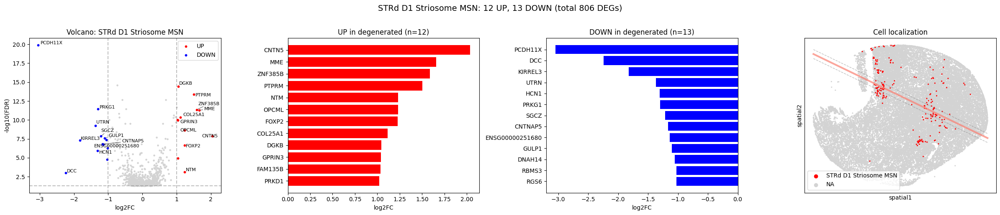


STRd D1 Striosome MSN:
  UP genes (12): ['CNTN5', 'MME', 'ZNF385B', 'PTPRM', 'NTM', 'OPCML', 'FOXP2', 'COL25A1', 'DGKB', 'GPRIN3', 'FAM135B', 'PRKD1']
  DOWN genes (13): ['PCDH11X', 'DCC', 'KIRREL3', 'UTRN', 'HCN1', 'PRKG1', 'SGCZ', 'CNTNAP5', 'ENSG00000251680', 'GULP1', 'DNAH14', 'RBMS3', 'RGS6']

Running MAST for: Tafa1 STRd D2 StrioMat Hybrid MSN
Contrast: degenerated vs intact (reference)

Cell counts: {'intact': 32, 'degenerated': 1}
ERROR: Insufficient cells
No df

Running MAST for: Tafa1 D1 Matrix MSN
Contrast: degenerated vs intact (reference)

Cell counts: {'intact': 219, 'degenerated': 1}
ERROR: Insufficient cells
No df

Running MAST for: STR D1D2 Hybrid MSN
Contrast: degenerated vs intact (reference)

Cell counts: {'degenerated': 605, 'intact': 172}


,pct_counts_mt,log1p_n_genes_by_counts
pct_counts_mt,1.000000,-0.423406
log1p_n_genes_by_counts,-0.423406,1.000000


,LOD_region,sample,log1p_n_genes_by_counts,library,pct_counts_mt
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---AAGTCCATCGTTCACT-1-SI-TT-H1,degenerated,sample_01,0.840925,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,-0.490195
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---ACAAGACAGCCTAGAC-1-SI-TT-H1,degenerated,sample_01,0.753781,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,1.722258
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---ACAAGATCACGCGACT-1-SI-TT-H1,degenerated,sample_01,1.312374,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,-0.359398


Model Formula ~ label + library + log1p_n_genes_by_counts + pct_counts_mt


R callback write-console: `fData` has no primerid.  I'll make something up.
  
R callback write-console: `cData` has no wellKey.  I'll make something up.
  
R callback write-console: Assuming data assay in position 1, with name X is log-transformed.
  


class: SingleCellAssay 
dim: 10235 777 
metadata(0):
assays(1): X
rownames(10235): ENSG00000291215 ENSG00000237491 ... ENSG00000278384
  ENSG00000273748
rowData names(20): feature_types genome ... log1p_total_counts primerid
colnames(777):
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---AAGTCCATCGTTCACT-1-SI-TT-H1
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---ACAAGACAGCCTAGAC-1-SI-TT-H1
  ...
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H3---GTTGGGCGTCAAGTTA-1-SI-TT-H3
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H3---GTTGTCCGTGGATGTT-1-SI-TT-H3
colData names(6): LOD_region sample ... pct_counts_mt wellKey
reducedDimNames(0):
mainExpName: NULL
altExpNames(0):


R callback write-console: 
Done!
  
R callback write-console: Combining coefficients and standard errors
  
R callback write-console: Calculating log-fold changes
  


Processed 102350 groups out of 102350. 100% done. Time elapsed: 7s. ETA: 0s.


R callback write-console: Calculating likelihood ratio tests
  
R callback write-console: Refitting on reduced model...
  
R callback write-console: 
Done!
  
R callback write-console: In addition:   
R callback write-console: There were 50 or more warnings (use warnings() to see the first 50)  
R callback write-console: 
  



RESULTS: 1247 DEGs (FDR < 0.05)
↑ 514 UP / ↓ 733 DOWN


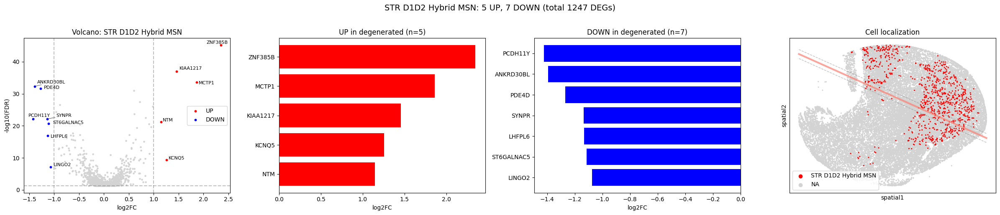


STR D1D2 Hybrid MSN:
  UP genes (5): ['ZNF385B', 'MCTP1', 'KIAA1217', 'KCNQ5', 'NTM']
  DOWN genes (7): ['PCDH11Y', 'ANKRD30BL', 'PDE4D', 'SYNPR', 'LHFPL6', 'ST6GALNAC5', 'LINGO2']

Running MAST for: STRd D2 Striosome MSN
Contrast: degenerated vs intact (reference)

Cell counts: {'degenerated': 69, 'intact': 43}


,pct_counts_mt,log1p_n_genes_by_counts
pct_counts_mt,1.000000,-0.056562
log1p_n_genes_by_counts,-0.056562,1.000000


,LOD_region,sample,log1p_n_genes_by_counts,library,pct_counts_mt
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---ATACCCGCACCTAGAT-1-SI-TT-H1,degenerated,sample_01,-1.073312,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,0.015783
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---CATTCCGTCCATGCCC-1-SI-TT-H1,intact,sample_01,-4.734423,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,-0.432998
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---CCGTCCAGTAGTATTG-1-SI-TT-H1,degenerated,sample_01,1.897842,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,0.111005


Model Formula ~ label + library + log1p_n_genes_by_counts + pct_counts_mt


R callback write-console: `fData` has no primerid.  I'll make something up.
  
R callback write-console: `cData` has no wellKey.  I'll make something up.
  
R callback write-console: Assuming data assay in position 1, with name X is log-transformed.
  


class: SingleCellAssay 
dim: 12358 112 
metadata(0):
assays(1): X
rownames(12358): ENSG00000291215 ENSG00000237491 ... ENSG00000278384
  ENSG00000273748
rowData names(20): feature_types genome ... log1p_total_counts primerid
colnames(112):
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---ATACCCGCACCTAGAT-1-SI-TT-H1
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---CATTCCGTCCATGCCC-1-SI-TT-H1
  ...
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H3---GTTGCCACAAGCTTAC-1-SI-TT-H3
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H3---GTTGCTTTCCCCTAGC-1-SI-TT-H3
colData names(6): LOD_region sample ... pct_counts_mt wellKey
reducedDimNames(0):
mainExpName: NULL
altExpNames(0):


R callback write-console: 
Done!
  
R callback write-console: Combining coefficients and standard errors
  
R callback write-console: Calculating log-fold changes
  


Processed 123580 groups out of 123580. 100% done. Time elapsed: 11s. ETA: 0s.


R callback write-console: Calculating likelihood ratio tests
  
R callback write-console: Refitting on reduced model...
  
R callback write-console: 
Done!
  
R callback write-console: In addition:   
R callback write-console: There were 50 or more warnings (use warnings() to see the first 50)  
R callback write-console: 
  



RESULTS: 560 DEGs (FDR < 0.05)
↑ 214 UP / ↓ 346 DOWN


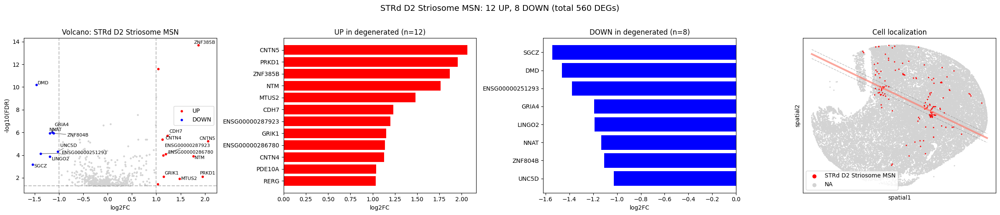


STRd D2 Striosome MSN:
  UP genes (12): ['CNTN5', 'PRKD1', 'ZNF385B', 'NTM', 'MTUS2', 'CDH7', 'ENSG00000287923', 'GRIK1', 'ENSG00000286780', 'CNTN4', 'PDE10A', 'RERG']
  DOWN genes (8): ['SGCZ', 'DMD', 'ENSG00000251293', 'GRIA4', 'LINGO2', 'NNAT', 'ZNF804B', 'UNC5D']

Running MAST for: STRd D1 Matrix MSN
Contrast: degenerated vs intact (reference)

Cell counts: {'intact': 16, 'degenerated': 12}


,pct_counts_mt,log1p_n_genes_by_counts
pct_counts_mt,1.000000,-0.756124
log1p_n_genes_by_counts,-0.756124,1.000000


,LOD_region,sample,log1p_n_genes_by_counts,library,pct_counts_mt
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---ATTGTCTGTCCTCTCC-1-SI-TT-H1,intact,sample_01,1.719334,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,-0.394519
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---CCTAATCTCCATATCC-1-SI-TT-H1,degenerated,sample_01,-3.853254,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,4.876342
240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---GGATATCGTCACTATT-1-SI-TT-H1,degenerated,sample_01,-1.310171,240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1,0.067520


Model Formula ~ label + library + log1p_n_genes_by_counts + pct_counts_mt


R callback write-console: `fData` has no primerid.  I'll make something up.
  
R callback write-console: `cData` has no wellKey.  I'll make something up.
  
R callback write-console: Assuming data assay in position 1, with name X is log-transformed.
  


class: SingleCellAssay 
dim: 10128 28 
metadata(0):
assays(1): X
rownames(10128): ENSG00000291215 ENSG00000237491 ... ENSG00000278384
  ENSG00000273748
rowData names(20): feature_types genome ... log1p_total_counts primerid
colnames(28):
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---ATTGTCTGTCCTCTCC-1-SI-TT-H1
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H1---CCTAATCTCCATATCC-1-SI-TT-H1
  ...
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H3---GGTATATTCGTACGTA-1-SI-TT-H3
  240805_SL-EXD_0328_B22FKKYLT4---SI-TT-H3---GTTCATTGTCGCGGAT-1-SI-TT-H3
colData names(6): LOD_region sample ... pct_counts_mt wellKey
reducedDimNames(0):
mainExpName: NULL
altExpNames(0):


R callback write-console: 
Done!
  
R callback write-console: Combining coefficients and standard errors
  
R callback write-console: Calculating log-fold changes
  


Processed 101280 groups out of 101280. 100% done. Time elapsed: 7s. ETA: 0s.


R callback write-console: Calculating likelihood ratio tests
  
R callback write-console: Refitting on reduced model...
  
R callback write-console: 
Done!
  
R callback write-console: In addition:   
R callback write-console: There were 50 or more warnings (use warnings() to see the first 50)  
R callback write-console: 
  



RESULTS: 267 DEGs (FDR < 0.05)
↑ 120 UP / ↓ 147 DOWN


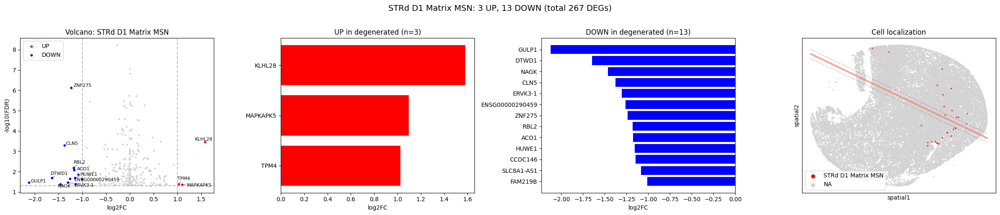


STRd D1 Matrix MSN:
  UP genes (3): ['KLHL28', 'MAPKAPK5', 'TPM4']
  DOWN genes (13): ['GULP1', 'DTWD1', 'NAGK', 'CLN5', 'ERVK3-1', 'ENSG00000290459', 'ZNF275', 'RBL2', 'ACO1', 'HUWE1', 'CCDC146', 'SLC8A1-AS1', 'FAM219B']


In [31]:

mast_deg_dfs = []


for ct in tqdm(adata.obs[CELL_TYPE_ANNOTATION_FOR_DEG_LOD].unique().tolist()[:]):

    results_with_covs = DEG.run_mast_deg(
        adata=adata,
        cell_type_col=CELL_TYPE_ANNOTATION_FOR_DEG_LOD,
        cell_type=ct,
        condition_col="LOD_region",
        contrast=CONTRAST,
        replicate_col="sample",
        additional_covariates=["pct_counts_mt", ],  # log1p_total_counts NO --> corr wiht "gene conits" ALWYS PRESNT in  mast
        library_col="library",
        min_cells_per_group=5,
        min_freq_per_gene=0.1,
        min_cells=5,
        fdr_cutoff=0.05)

    mast_deg_dfs.append(mast_deg_dfs)

    plot_deg_simple(
        results_with_covs, 
        adata, 
        CONTRAST, 
        CELL_TYPE_ANNOTATION_FOR_DEG_LOD,
        col_fc="log2FC",
        col_p="FDR",
        col_dir="direction",
        col_gene="gene_symbol",
        fc_thr=1, p_thr=0.05,
        top_bar=15, top_label=10
    )

---
---
---

# Cell cycle Regression ???

In [7]:
# Your current mapping (Ensembl → Symbol)
symbol_to_ensembl = adata.var["gene_symbol"].to_dict()
# This gives: {'ENSG00000243485': 'MIR1302-2HG', ...}

# What you NEED (Symbol → Ensembl)
ensembl_to_symbol = {symbol: ensembl for ensembl, symbol in symbol_to_ensembl.items()}
# This gives: {'MIR1302-2HG': 'ENSG00000243485', ...}

ensembl_to_symbol

{'MIR1302-2HG': 'ENSG00000243485',
 'ENSG00000290826': 'ENSG00000290826',
 'ENSG00000238009': 'ENSG00000238009',
 'ENSG00000239945': 'ENSG00000239945',
 'ENSG00000239906': 'ENSG00000239906',
 'ENSG00000241860': 'ENSG00000241860',
 'ENSG00000286448': 'ENSG00000286448',
 'ENSG00000290385': 'ENSG00000290385',
 'ENSG00000291215': 'ENSG00000291215',
 'ENSG00000229905': 'ENSG00000229905',
 'LINC01409': 'ENSG00000237491',
 'ENSG00000290784': 'ENSG00000290784',
 'FAM87B': 'ENSG00000177757',
 'LINC00115': 'ENSG00000225880',
 'LINC01128': 'ENSG00000228794',
 'ENSG00000288531': 'ENSG00000288531',
 'FAM41C': 'ENSG00000230368',
 'ENSG00000272438': 'ENSG00000272438',
 'ENSG00000230699': 'ENSG00000230699',
 'LINC02593': 'ENSG00000223764',
 'SAMD11': 'ENSG00000187634',
 'NOC2L': 'ENSG00000188976',
 'KLHL17': 'ENSG00000187961',
 'PLEKHN1': 'ENSG00000187583',
 'PERM1': 'ENSG00000187642',
 'ENSG00000272512': 'ENSG00000272512',
 'HES4': 'ENSG00000188290',
 'ISG15': 'ENSG00000187608',
 'ENSG00000224969': '

S genes found: 43/43
G2M genes found: 54/54

Cell cycle distribution:
phase
S      10475
G1      9567
G2M     9002
Name: count, dtype: int64


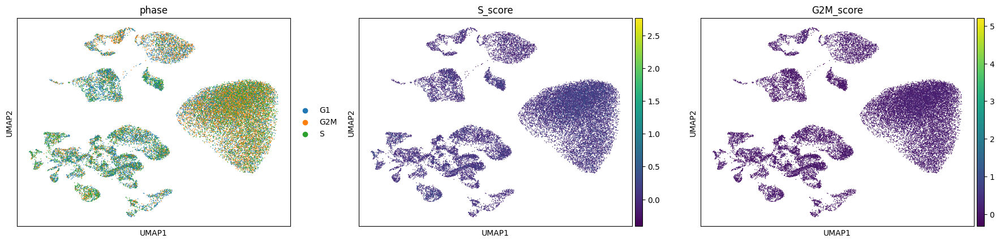

In [8]:
# ==========================================
# STEP 1: Score cell cycle genes
# ==========================================

s_genes = ['MCM5', 'PCNA', 'TYMS', 'FEN1', 'MCM2', 'MCM4', 'RRM1', 'UNG', 
                 'GINS2', 'MCM6', 'CDCA7', 'DTL', 'PRIM1', 'UHRF1', 'CENPU', 
                 'HELLS', 'RFC2', 'RPA2', 'NASP', 'RAD51AP1', 'GMNN', 'WDR76', 
                 'SLBP', 'CCNE2', 'UBR7', 'POLD3', 'MSH2', 'ATAD2', 'RAD51', 
                 'RRM2', 'CDC45', 'CDC6', 'EXO1', 'TIPIN', 'DSCC1', 'BLM', 
                 'CASP8AP2', 'USP1', 'CLSPN', 'POLA1', 'CHAF1B', 'BRIP1', 'E2F8']

g2m_genes = ['HMGB2', 'CDK1', 'NUSAP1', 'UBE2C', 'BIRC5', 'TPX2', 'TOP2A',
                   'NDC80', 'CKS2', 'NUF2', 'CKS1B', 'MKI67', 'TMPO', 'CENPF',
                   'TACC3', 'PIMREG', 'SMC4', 'CCNB2', 'CKAP2L', 'CKAP2', 'AURKB',
                   'BUB1', 'KIF11', 'ANP32E', 'TUBB4B', 'GTSE1', 'KIF20B', 'HJURP',
                   'CDCA3', 'JPT1', 'CDC20', 'TTK', 'CDC25C', 'KIF2C', 'RANGAP1',
                   'NCAPD2', 'DLGAP5', 'CDCA2', 'CDCA8', 'ECT2', 'KIF23', 'HMMR',
                   'AURKA', 'PSRC1', 'ANLN', 'LBR', 'CKAP5', 'CENPE', 'CTCF',
                   'NEK2', 'G2E3', 'GAS2L3', 'CBX5', 'CENPA']

# Convert symbols to Ensembl IDs
s_genes_ensembl = [ensembl_to_symbol.get(gene, None) for gene in s_genes]
g2m_genes_ensembl = [ensembl_to_symbol.get(gene, None) for gene in g2m_genes]

# Filter out None values (genes not found)
s_genes_present = [g for g in s_genes_ensembl if g is not None]
g2m_genes_present = [g for g in g2m_genes_ensembl if g is not None]

print(f"S genes found: {len(s_genes_present)}/{len(s_genes)}")
print(f"G2M genes found: {len(g2m_genes_present)}/{len(g2m_genes)}")

# Calculate scores
sc.tl.score_genes_cell_cycle(
    adata, 
    s_genes=s_genes_present, 
    g2m_genes=g2m_genes_present
)

# This adds to adata.obs:
# - 'S_score': S phase score
# - 'G2M_score': G2M phase score  
# - 'phase': Categorical (G1, S, G2M)

print("\nCell cycle distribution:")
print(adata.obs['phase'].value_counts())


# ==========================================
# STEP 2: Visualize BEFORE regression
# ==========================================

sc.pl.umap(adata, color=['phase', 'S_score', 'G2M_score'], ncols=3)

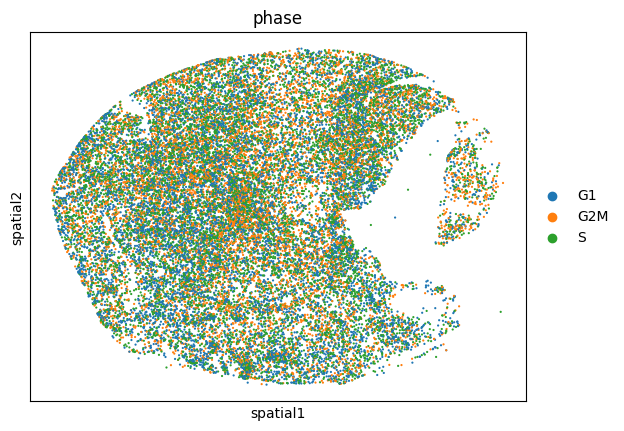

In [95]:
sc.pl.embedding(adata, basis="spatial", color=['phase'], ncols=3, size=10)

In [9]:
cell_cycle_genes = [*s_genes_present, *g2m_genes_present]
adata_cc_genes = adata[:, cell_cycle_genes].copy()
sc.tl.pca(adata_cc_genes, n_comps=min(50, len(cell_cycle_genes)-1),  svd_solver='arpack')
sc.pl.pca_scatter(adata_cc_genes, color="phase")

ValueError: Found array with 0 feature(s) (shape=(29044, 0)) while a minimum of 1 is required by PCA.

In [ ]:
# Your current mapping (Ensembl → Symbol)
symbol_to_ensembl = adata.var["gene_symbol"].to_dict()
# This gives: {'ENSG00000243485': 'MIR1302-2HG', ...}

# What you NEED (Symbol → Ensembl)
ensembl_to_symbol = {symbol: ensembl for ensembl, symbol in symbol_to_ensembl.items()}
# This gives: {'MIR1302-2HG': 'ENSG00000243485', ...}

ensembl_to_symbol

{'MIR1302-2HG': 'ENSG00000243485',
 'ENSG00000290826': 'ENSG00000290826',
 'ENSG00000238009': 'ENSG00000238009',
 'ENSG00000239945': 'ENSG00000239945',
 'ENSG00000239906': 'ENSG00000239906',
 'ENSG00000241860': 'ENSG00000241860',
 'ENSG00000286448': 'ENSG00000286448',
 'ENSG00000290385': 'ENSG00000290385',
 'ENSG00000291215': 'ENSG00000291215',
 'ENSG00000229905': 'ENSG00000229905',
 'LINC01409': 'ENSG00000237491',
 'ENSG00000290784': 'ENSG00000290784',
 'FAM87B': 'ENSG00000177757',
 'LINC00115': 'ENSG00000225880',
 'LINC01128': 'ENSG00000228794',
 'ENSG00000288531': 'ENSG00000288531',
 'FAM41C': 'ENSG00000230368',
 'ENSG00000272438': 'ENSG00000272438',
 'ENSG00000230699': 'ENSG00000230699',
 'LINC02593': 'ENSG00000223764',
 'SAMD11': 'ENSG00000187634',
 'NOC2L': 'ENSG00000188976',
 'KLHL17': 'ENSG00000187961',
 'PLEKHN1': 'ENSG00000187583',
 'PERM1': 'ENSG00000187642',
 'ENSG00000272512': 'ENSG00000272512',
 'HES4': 'ENSG00000188290',
 'ISG15': 'ENSG00000187608',
 'ENSG00000224969': '

In [91]:
adata_regressed_full = adata.copy()

sc.pp.regress_out(adata_regressed_full, ['S_score', 'G2M_score'], layer="log1p_norm")
sc.pp.scale(adata_regressed_full, max_value=10)

print("\n✓ Regressed out both S and G2M scores (removes all cell cycle)")

/home/gdallagl/myworkdir/XDP/.venv/lib/python3.11/site-packages/scanpy/preprocessing/_scale.py:199: RuntimeWarning: invalid value encountered in sqrt
  std = np.sqrt(var)



✓ Regressed out both S and G2M scores (removes all cell cycle)


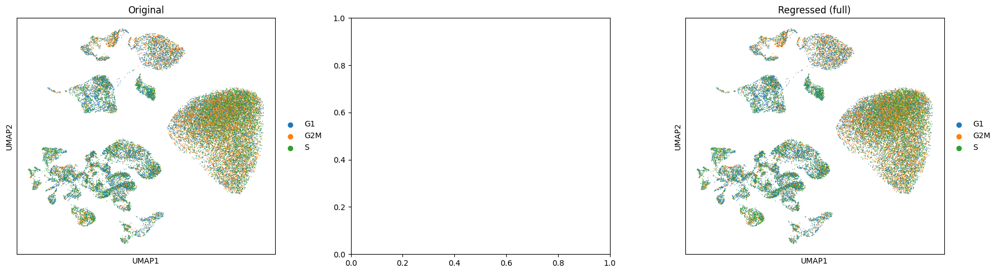

In [86]:
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

sc.pl.umap(adata, color='phase', title='Original', ax=axes[0], show=False)
sc.pl.umap(adata_regressed_full, color='phase', title='Regressed (full)', ax=axes[2], show=False)

plt.tight_layout()
plt.show()

In [93]:
cc_by_region = pd.crosstab(adata.obs['LOD_region'], adata.obs['phase'], normalize='index')
display(cc_by_region)


# Statistical test
from scipy.stats import chi2_contingency

cc_by_region = pd.crosstab(adata.obs['LOD_region'], adata.obs['phase'])
chi2, pval, dof, expected = chi2_contingency(cc_by_region)

print(f"Chi-squared test: p = {pval:.4e}")
if pval < 0.05:
    print("⚠️ Cell cycle SIGNIFICANTLY differs between regions!")
else:
    print("✓ No significant difference in cell cycle")

phase,G1,G2M,S
LOD_region,,,
LOD,0.330042,0.335214,0.334744
degenerated,0.295789,0.333844,0.370368
intact,0.360973,0.283539,0.355488


Chi-squared test: p = 1.9503e-32
⚠️ Cell cycle SIGNIFICANTLY differs between regions!


# Squidpy

In [ ]:
# ==========================================
# SQUIDPY HAS BUILT-IN SPATIAL ANALYSIS!
# ==========================================

import squidpy as sq

# Squidpy has several relevant functions:

# --------------------------------------------------
# 1. Spatial Statistics (Ripley's K, etc.)
# --------------------------------------------------
sq.gr.ripley(
    adata,
    cluster_key=CELL_TYPE_COL,
    mode="K"  # or "L", "G"
)
# → Tests if cell types are clustered or dispersed

# --------------------------------------------------
# 2. Co-occurrence (which cell types are neighbors?)
# --------------------------------------------------
sq.gr.co_occurrence(
    adata,
    cluster_key=CELL_TYPE_COL,
    spatial_key="spatial"
)
# → Creates matrix of cell type co-occurrence

# --------------------------------------------------
# 3. Neighborhood Enrichment
# --------------------------------------------------
sq.gr.nhood_enrichment(
    adata,
    cluster_key=CELL_TYPE_COL,
    spatial_key="spatial"
)

sq.pl.nhood_enrichment(adata, cluster_key=CELL_TYPE_COL)
# → Shows which cell types are enriched near each other

# --------------------------------------------------
# 4. Spatial Autocorrelation (Moran's I)
# --------------------------------------------------
sq.gr.spatial_autocorr(
    adata,
    mode="moran",
    n_perms=100,
    genes=adata.var_names[:100]  # Test specific genes
)
# → Tests if gene expression is spatially clustered

# --------------------------------------------------
# 5. Interaction Matrix
# --------------------------------------------------
sq.gr.interaction_matrix(
    adata,
    cluster_key=CELL_TYPE_COL,
    spatial_key="spatial"
)
# → Quantifies spatial interactions between cell types
